<a href="https://colab.research.google.com/github/ahmadryan/covid19/blob/master/coronavirus_models_qudsi.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**a quick, possibly (certainly) buggy analysis of the cornavirus data on Kaggle https://www.kaggle.com/sudalairajkumar/novel-corona-virus-2019-dataset**

Visualizing the number of deaths, and the presence of the virus by country

TODO: 
* export the bokeh interactive plot to the web
* normalize by population
* review and kill bugs
* review and simplify syntax
* review and comment for posterity

In [0]:
!pip install geopandas
!pip install shapely

     |████████████████████████████████| 931kB 4.8MB/s 
     |████████████████████████████████| 10.4MB 34.5MB/s 
     |████████████████████████████████| 14.7MB 28.9MB/s 


In [0]:
import pandas as pd
import pylab as pl
import geopandas as gpd
import shapely
import json

%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [0]:
#remove warnings
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")


In [0]:
#bokeh imports
from bokeh.io import output_file, show, output_notebook, export_png
from bokeh.models import ColumnDataSource, GeoJSONDataSource, LinearColorMapper, ColorBar
from bokeh.plotting import figure
from bokeh.palettes import brewer
from bokeh.models import HoverTool
from bokeh.palettes import viridis, inferno, cividis, plasma, gray


In [0]:
#does not work on colab
#!pip install panel
#import panel as pn
#import panel.widgets as pnw
#pn.extension()
#output_notebook()
#output_file("test.html")


In [0]:
# most of the data I grab from online links 
# but the shapefiles downloaded and saved on data/
# the last part of the analysis uses worldbank data 
# which I also downloaded and saved on data/ - that could be changed
from google.colab import drive

drive.mount("/content/gdrive")


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
cd gdrive/My\ Drive


/content/gdrive/My Drive


In [0]:
cd Colab\ Notebooks

/content/gdrive/My Drive/Colab Notebooks


# COVID-19 death analysis



In [0]:
# JHU database on COVID-19
root = "https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/"
# get the number of dead people
deaths = pd.read_csv(root + "/time_series_19-covid-Deaths.csv")


In [0]:
deaths.describe()

,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20
count,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000,463.000000
mean,31.813752,-36.125732,0.036717,0.038877,0.056156,0.090713,0.120950,0.177106,0.282937,0.287257,0.369330,0.460043,0.559395,0.781857,0.920086,1.062635,1.218143,1.369330,1.552916,1.740821,1.956803,2.187905,2.403888,2.414687,2.961123,3.289417,3.598272,3.822894,4.034557,4.334773,4.583153,4.853132,4.861771,5.308855,5.332613,5.678186,5.848812,5.982721,6.077754,6.203024,6.352052,6.470842,6.663067,6.825054,7.028078,7.231102,7.473002,7.684665,8.211663,8.613391,9.205184,9.967603,10.194384,11.671706,12.568035,13.909287,15.390929
std,18.726309,80.335192,0.790057,0.791322,1.117104,1.859916,2.418018,3.533230,5.809742,5.810275,7.529717,9.481243,11.572295,16.265849,19.240000,22.260616,25.513555,28.720245,32.484444,36.248926,40.478126,45.264749,49.633450,49.633557,60.879828,67.711752,74.171518,78.818322,83.140853,89.275743,94.294263,99.637699,99.637451,109.024272,109.024112,115.948517,119.109352,121.526544,122.737844,124.647094,126.746087,128.335914,130.311161,131.834844,133.566695,135.106406,136.611937,138.069262,140.046230,141.801656,144.114444,147.508606,148.376806,155.779134,160.410429,169.839459,180.380480
min,-41.454500,-157.858400,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,27.612200,-92.721500,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,37.809900,-74.297300,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,42.324400,20.921200,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0

In [0]:
deaths.columns

Index(['Province/State', 'Country/Region', 'Lat', 'Long', '1/22/20', '1/23/20',
       '1/24/20', '1/25/20', '1/26/20', '1/27/20', '1/28/20', '1/29/20',
       '1/30/20', '1/31/20', '2/1/20', '2/2/20', '2/3/20', '2/4/20', '2/5/20',
       '2/6/20', '2/7/20', '2/8/20', '2/9/20', '2/10/20', '2/11/20', '2/12/20',
       '2/13/20', '2/14/20', '2/15/20', '2/16/20', '2/17/20', '2/18/20',
       '2/19/20', '2/20/20', '2/21/20', '2/22/20', '2/23/20', '2/24/20',
       '2/25/20', '2/26/20', '2/27/20', '2/28/20', '2/29/20', '3/1/20',
       '3/2/20', '3/3/20', '3/4/20', '3/5/20', '3/6/20', '3/7/20', '3/8/20',
       '3/9/20', '3/10/20', '3/11/20', '3/12/20', '3/13/20', '3/14/20',
       '3/15/20', '3/16/20'],
      dtype='object')

In [0]:
firstdate = pd.to_datetime(deaths.columns[4])
firstdate

Timestamp('2020-01-22 00:00:00')

In [0]:
deaths.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20
0,NaN,Thailand,15.0000,101.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
1,NaN,Japan,36.0000,138.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,2,4,4,5,6,6,6,6,6,6,6,6,10,10,15,16,19,22,22,27
2,NaN,Singapore,1.2833,103.8333,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,NaN,Nepal,28.1667,84.2500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,NaN,Malaysia,2.5000,112.5000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [0]:
# last day contains the cumulative death rate
deaths["totaldeaths"] = deaths[deaths.columns[-1]]

In [0]:
# combine lat and lon to one column
lonlat = list(zip(deaths.Long, 
                  deaths.Lat))

In [0]:
deaths.tail()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,totaldeaths
458,NaN,Somalia,5.1521,46.1996,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
459,NaN,Tanzania,-6.3690,34.8888,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
460,NaN,The Bahamas,24.2500,-76.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
461,Virgin Islands,US,18.3358,-64.8963,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
462,Cayman Islands,United Kingdom,19.3133,-81.2546,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1


In [0]:
# creating the geometry
# Create Point Geometry for based on lonlat column

deaths.reset_index(inplace=True)
deaths = gpd.GeoDataFrame(deaths)
deaths["lonlat"] = lonlat

deaths['geometry'] = deaths[['lonlat']].applymap(lambda x:shapely.geometry.Point(x))
deaths.head()

,index,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,totaldeaths,lonlat,geometry
0,0,NaN,Thailand,15.0000,101.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,"(101.0, 15.0)",POINT (101.00000 15.00000)
1,1,NaN,Japan,36.0000,138.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,2,4,4,5,6,6,6,6,6,6,6,6,10,10,15,16,19,22,22,27,27,"(138.0, 36.0)",POINT (138.00000 36.00000)
2,2,NaN,Singapore,1.2833,103.8333,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"(103.8333, 1.2833)",POINT (103.83330 1.28330)
3,3,NaN,Nepal,28.1667,84.2500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"(84.25, 28.1667)",POINT (84.25000 28.16670)
4,4,NaN,Malaysia,2.5000,112.5000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"(112.5, 2.5)",POINT (112.50000 2.50000)


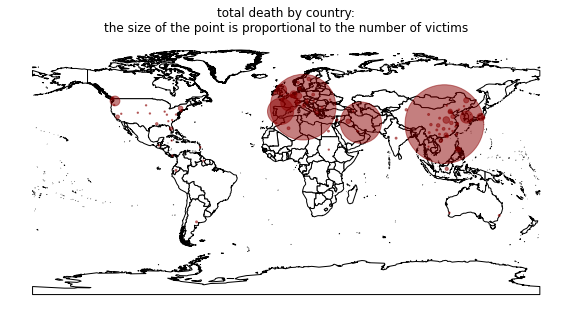

In [0]:
world = gpd.GeoDataFrame.from_file("data/TM_WORLD_BORDERS_SIMPL-0.3.shp")
ax = world.plot(figsize=(10,10), edgecolor="k", facecolor="w")
deaths.plot(ax=ax, #column="Country/Region", 
            markersize=deaths.totaldeaths * 2, alpha=0.5, color='DarkRed')
ax.axis("off");
ax.set_title("total death by country:\n" + 
             "the size of the point is proportional to the number of victims" );

In [0]:
# I want the data as granular as country. 
# More granular would be great but I could not map it wasily 
# (I would need to find a map of provinces worldwide 
# and do a lot of name matching to merge properly)
deaths["Country/Region"].replace("Mainland China", "China", inplace=True)
deaths["Country/Region"].replace("UK", "United Kingdom", inplace=True)
deaths["Country/Region"].replace("US", "United States", inplace=True)
deaths = deaths.groupby("Country/Region").sum()
deaths['logtotaldeaths'] = np.log10(deaths['totaldeaths'] + 1)

In [0]:
deaths["firstoccurrence"] = np.zeros(len(deaths)) * np.nan
for i in deaths.index:
    done = False
    for j in range(0, len(deaths.columns)):
        #print(i,j, deaths.iloc[i,j], done)
        if done:
            break
        try :
          pd.to_datetime(deaths.columns[j])
        except ValueError:
          continue
        #print(i, j, deaths.iloc[i,j])
        if (deaths.loc[i][j]) > 0: 
            #print("\t", i,j, deaths.iloc[i,j], done)
            deaths.loc[i, "firstoccurrence"] = pd.to_datetime(deaths.columns[j])          
            done = True
 


In [0]:
 deaths["firstoccurrence"] 

Country/Region
Afghanistan                                       NaN
Albania                           2020-03-11 00:00:00
Algeria                           2020-03-12 00:00:00
Andorra                                           NaN
Antigua and Barbuda                               NaN
                                         ...         
Uruguay                                           NaN
Uzbekistan                                        NaN
Venezuela                                         NaN
Vietnam                                           NaN
occupied Palestinian territory                    NaN
Name: firstoccurrence, Length: 156, dtype: object

In [0]:
deaths.iloc[0, 0], deaths.iloc[0, j], i, j, deaths.columns[j]

(26, nan, 'occupied Palestinian territory', 60, 'firstoccurrence')

In [0]:
deaths.describe()

,index,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,totaldeaths,logtotaldeaths
count,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000,156.000000
mean,685.596154,94.421583,-107.219321,0.108974,0.115385,0.166667,0.269231,0.358974,0.525641,0.839744,0.852564,1.096154,1.365385,1.660256,2.320513,2.730769,3.153846,3.615385,4.064103,4.608974,5.166667,5.807692,6.493590,7.134615,7.166667,8.788462,9.762821,10.679487,11.346154,11.974359,12.865385,13.602564,14.403846,14.429487,15.756410,15.826923,16.852564,17.358974,17.756410,18.038462,18.410256,18.852564,19.205128,19.775641,20.256410,20.858974,21.461538,22.179487,22.807692,24.371795,25.564103,27.320513,29.583333,30.256410,34.641026,37.301282,41.282051,45.679487,45.679487,0.287671
std,5331.603573,766.956738,1869.388348,1.361089,1.441153,2.081666,3.362691,4.483588,6.565254,10.488394,10.648522,13.690957,17.053648,20.736596,28.902726,34.026810,39.311027,45.075630,50.680107,57.485546,64.451115,72.457517,81.024369,89.030773,89.431093,109.606746,121.776480,133.145082,141.391183,149.237457,160.366358,169.412635,179.178980,179.177192,195.589444,195.746220,207.752794,213.355464,217.516462,219.837591,223.362135,227.129885,229.940910,233.325927,236.013883,238.973300,241.677268,244.230734,246.705992,250.066655,253.063505,256.854521,262.435712,263.947328,276.190676,283.800189,299.392154,316.893897,316.893897,0.622162
min,0.000000,-220.525800,-22951.820900,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,44.750000,7.405000,-9.496275,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,86.500000,24.802400,18.084750,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,4

In [0]:
print ("as of {}".format(pd.to_datetime("today").date()))
print ("number of countries in the database {:d}".format(len(deaths)))
print ("number of countries with at least 1 death {:d}".format(
    (deaths.totaldeaths > 0).sum()))

as of 2020-03-17
number of countries in the database 156
number of countries with at least 1 death 49


In [0]:
# how many days are in the database?
maxday = pd.Timedelta(pd.to_datetime("today").normalize() - pd.to_datetime("01/01/2020"))
maxday -= pd.Timedelta(2, unit="day")
maxday

Timedelta('74 days 00:00:00')

In [0]:
# it will be convenient to have the log number, instead of the natural number, 
# or maps will have too much contrast 
# I am adding it to columns with columname the date, but as a string
def addlogbydate(df):
  for d in df.columns:
    try :
      pd.to_datetime(d)
    except ValueError:
      continue
    df[pd.to_datetime(d).strftime('%Y-%m-%d')] = np.log10(df[d] + 1)
  return df
deaths = addlogbydate(deaths).reset_index()
deaths

,Country/Region,index,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,2020-02-06,2020-02-07,2020-02-08,2020-02-09,2020-02-10,2020-02-11,2020-02-12,2020-02-13,2020-02-14,2020-02-15,2020-02-16,2020-02-17,2020-02-18,2020-02-19,2020-02-20,2020-02-21,2020-02-22,2020-02-23,2020-02-24,2020-02-25,2020-02-26,2020-02-27,2020-02-28,2020-02-29,2020-03-01,2020-03-02,2020-03-03,2020-03-04,2020-03-05,2020-03-06,2020-03-07,2020-03-08,2020-03-09,2020-03-10,2020-03-11,2020-03-12,2020-03-13,2020-03-14,2020-03-15,2020-03-16
0,Afghanistan,26,33.0000,65.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.00000,0.000000,0.00000,0.00000,0.00000
1,Albania,95,41.1533,20.1683,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.30103,0.30103,0.301030,0.30103,0.30103,0.30103
2,Algeria,29,28.0339,1.6596,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.30103,0.477121,0.60206,0.69897,0.69897
3,Andorra,60,42.5063,1.5218,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.00000,0.000000,0.00000,0.00000,0.00000
4,Antigua and Barbuda,416,17.0608,-61.7964,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.00000,0.000000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151,Uruguay,418,-32.5228,-55.7658,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.00000,0.000000,0.00000,0.00000,0.00000
152,Uzbekistan,445,41.3775,64.5853,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.00000,0.000000,0.00000,0.00000,0.00000
153,Venezuela,425,6.4238,-66.5897,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.00000,0.000000,0.00000,0.00000,0.00000
154,Vietnam,191,16.0000,108.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00000,0.00000,0.000000,0.00000,0.00000,0.00000


In [0]:
def get_dataset(df=deaths, day=25, key="firstoccurrence"):
    ''' this produces a geodataframe by country with the number of deaths by day
    df: the dataframe with covid data
    day: the date to be plotted in days since 01/01/2020
    key: only used if day is None - name of a column, it will extract data for that column
    returns the dataframe combined with a world map and converted to a dataframe, the column used'''
    if day is None:
      newt = key
    else:
      newt = (pd.to_datetime("1/1/2020") + pd.Timedelta(day, "D")).strftime('%Y-%m-%d')
  
    if newt not in df.columns:
        newt = firstdate.strftime('%Y-%m-%d')
    
    worlddeaths = world[["NAME", "geometry"]].merge(
        df[["Country/Region", newt]], 
        left_on="NAME", right_on="Country/Region", how="left")
    
    worlddeaths = gpd.GeoDataFrame(worlddeaths.groupby("NAME").sum().reset_index(
    ).merge(worlddeaths[["NAME", "geometry"]].drop_duplicates(subset="NAME"), 
            on="NAME", how="left"))
    worlddeaths[newt] = worlddeaths[newt].fillna(0)
    
    return worlddeaths, newt
#get_dataset(1)

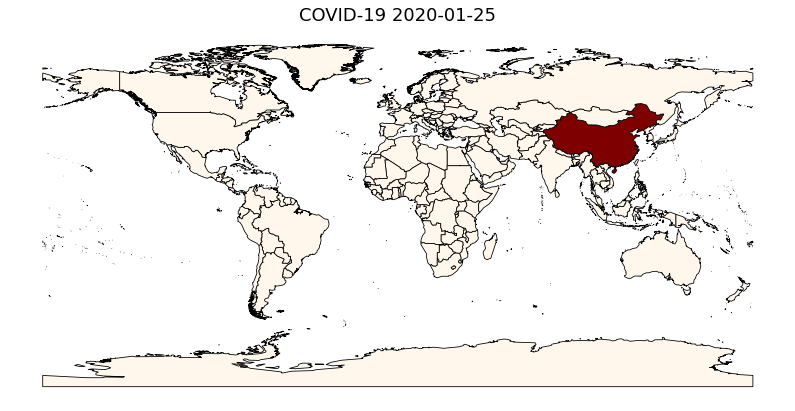

In [0]:
data, key = get_dataset(day=24)

fig, ax = plt.subplots(1, figsize=(14, 8))
data.plot(column=key, 
          clim=(0,100), cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black')
ax.axis('off')
ax.set_title('COVID-19 %s'%key, fontsize=18);

In [0]:
# this is for a dynamic bokeh map that does not work on google colab
def map_dash():
    """Map dashboard"""

    from bokeh.models.widgets import DataTable
    map_pane = pn.pane.Bokeh(width=400, height=300)
    #data_select = pnw.Select(name='dataset',options=list(
    #    datatmp))
    day_slider = pnw.IntSlider(start=22, end=90, value=25)
    
    def update_map(event):
        #data,key = get_dataset(day=0)
        #data = gpd.GeoDataFrame(data.groupby("NAME").sum().reset_index(
        #    ).merge(data[["NAME", "geometry"]].drop_duplicates(subset="NAME"), 
        #        on="NAME", how="left"))#.plot()

        gdf,key = get_dataset(day=day_slider.value)        
        #print("here", gdf, key)
        map_pane.object = bokeh_plot_map(gdf, key)        
        return
    day_slider.param.watch(update_map,'value')
    day_slider.param.trigger('value')
    #data_select.param.watch(update_map,'value')
    app = pn.Column(pn.Row("days since 01/01/2020", #data_select, 
        day_slider),map_pane)
    return app

#app = map_dash()
#app

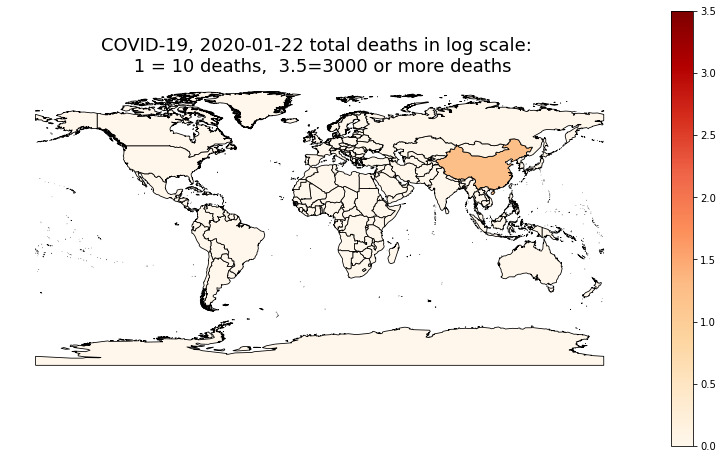

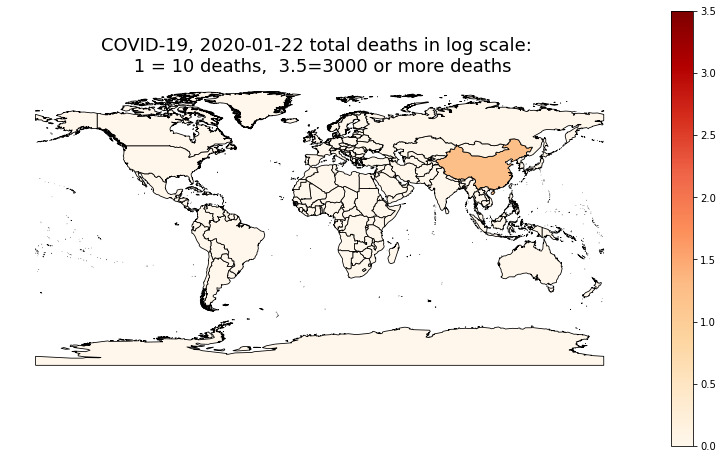

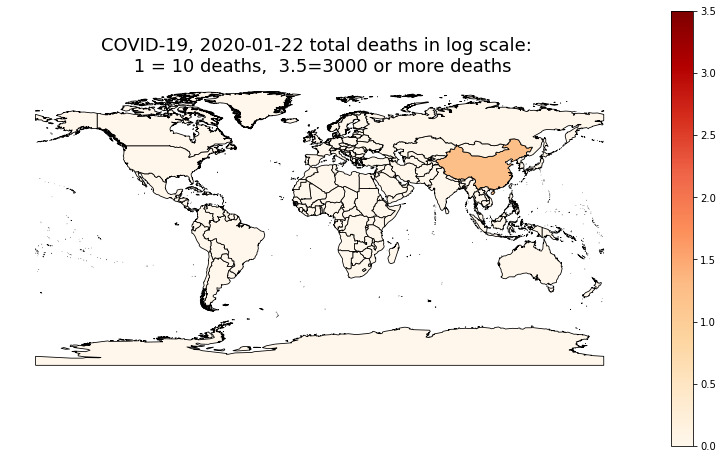

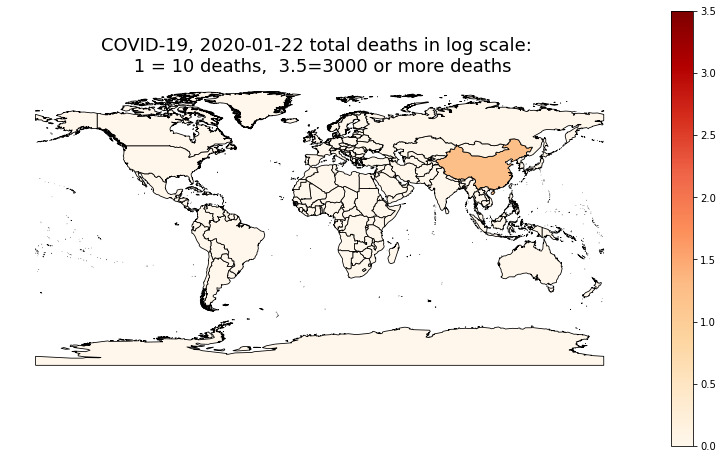

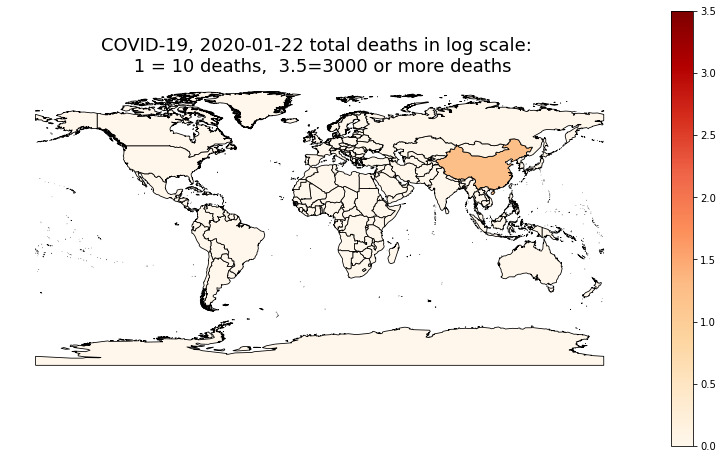

...

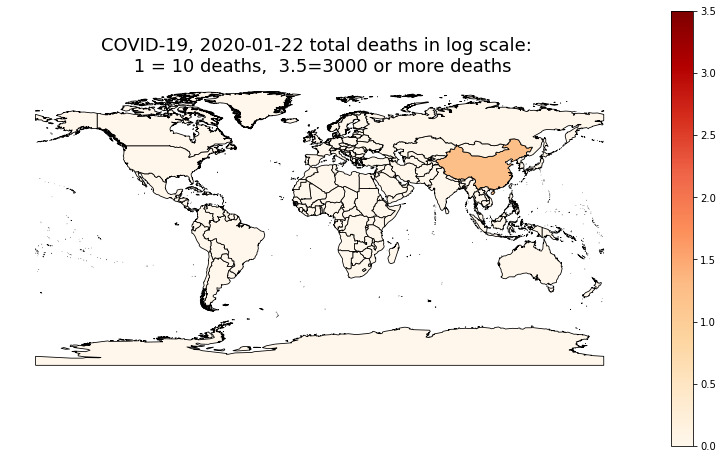

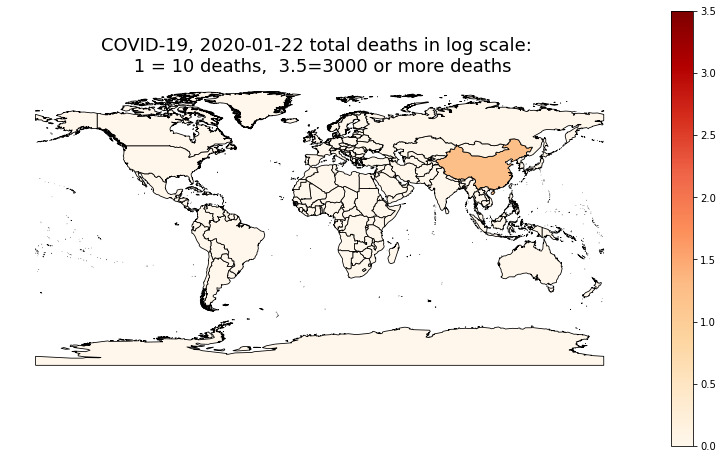

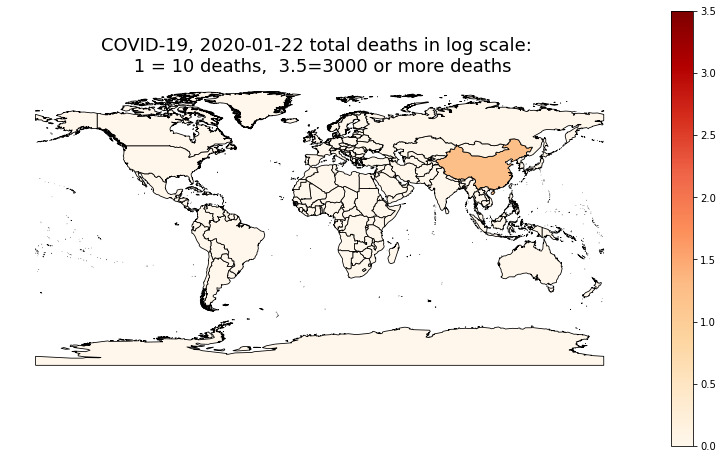

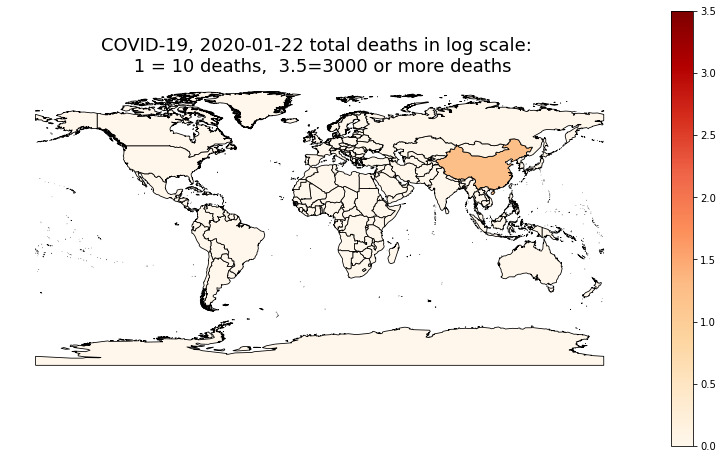

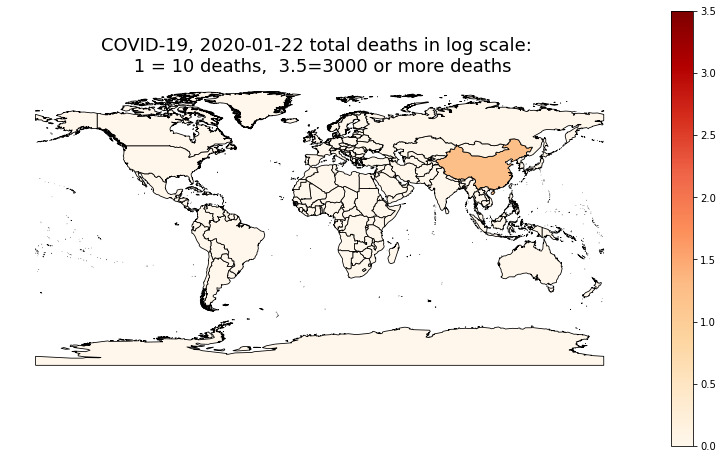

In [0]:
for day in range(0,90):
    data,key = get_dataset(day=day)
    fig, ax = plt.subplots(1, figsize=(14, 8))
    data.plot(column=key, cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black', 
              legend=True, vmin=0, vmax=3.5)
    
    ax.axis('off')
    ax.set_title('COVID-19, %s total deaths in log scale: \n 1 = 10 deaths,  3.5=3000 or more deaths'%key, fontsize=18);
    pl.savefig("figs/COVID-19-deaths-%s.png"%key)
    pl.show()
    pl.close(fig)

In [0]:
!convert -loop -1 -delay 50 figs/COVID-19-deaths-*.png figs/COVID-19-deaths.gif

/bin/bash: convert: command not found


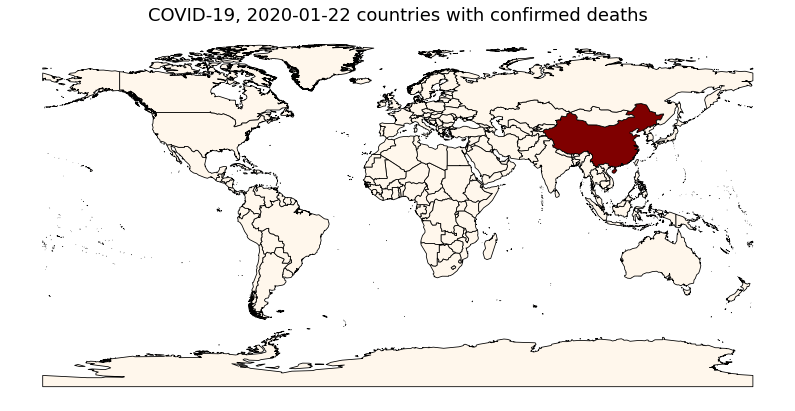

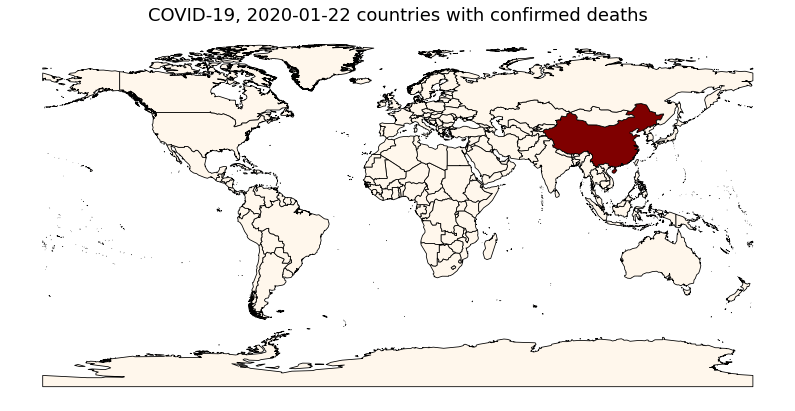

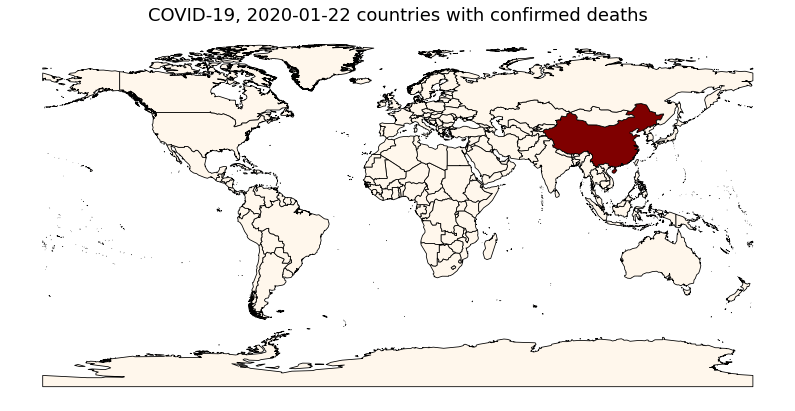

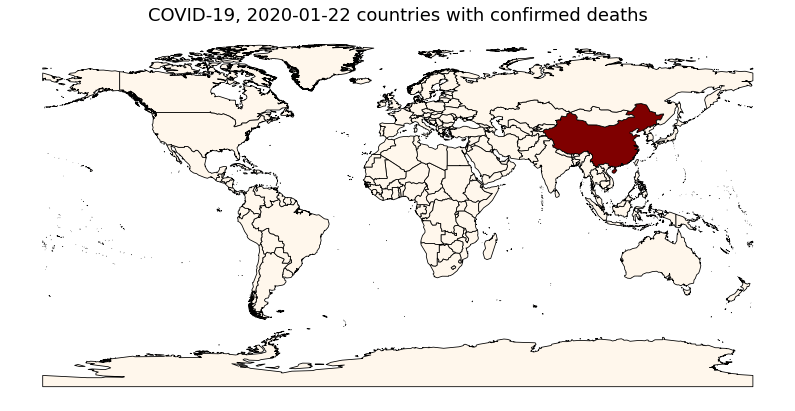

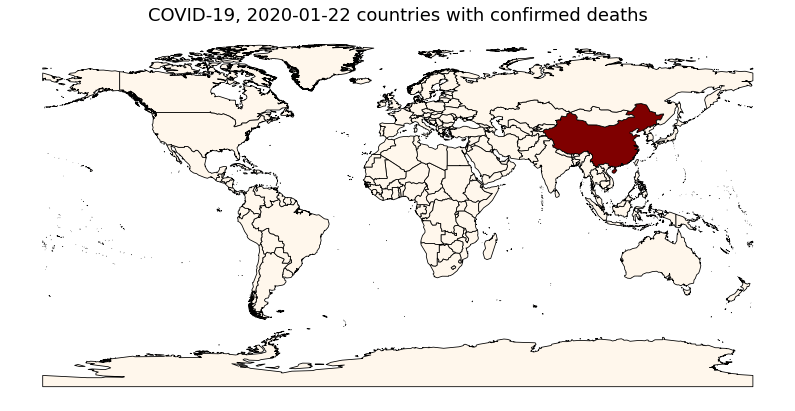

...

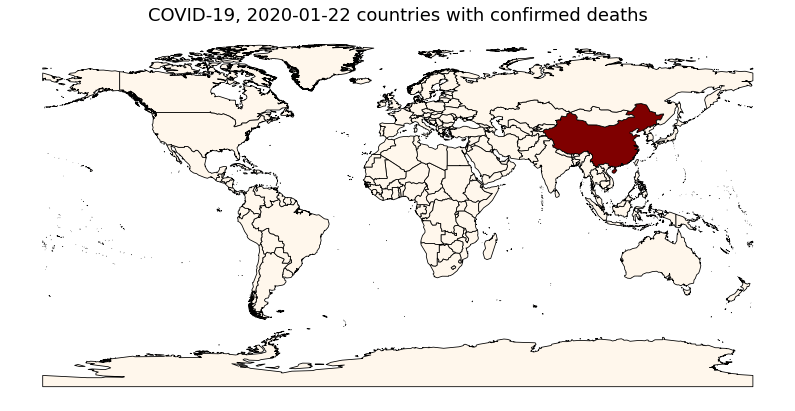

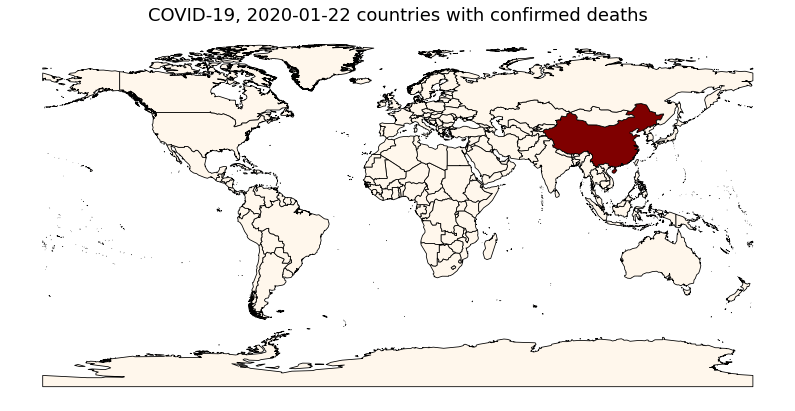

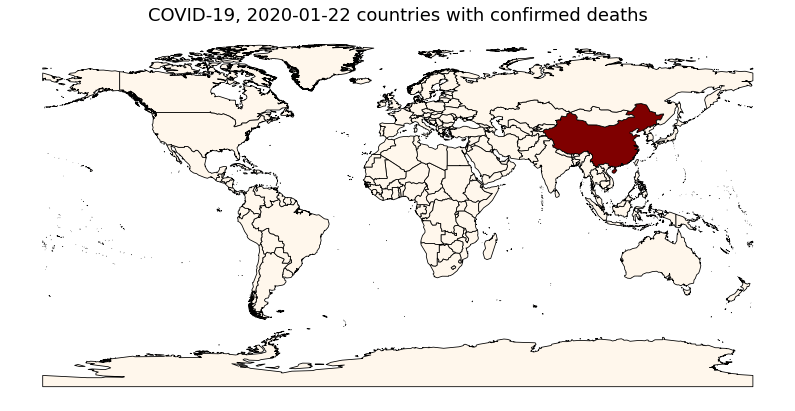

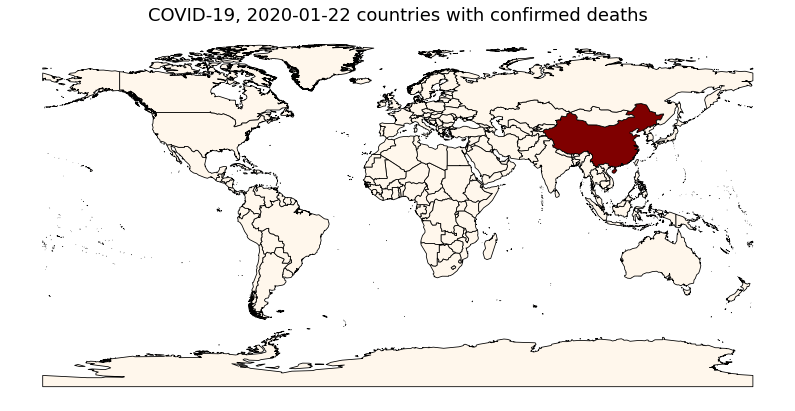

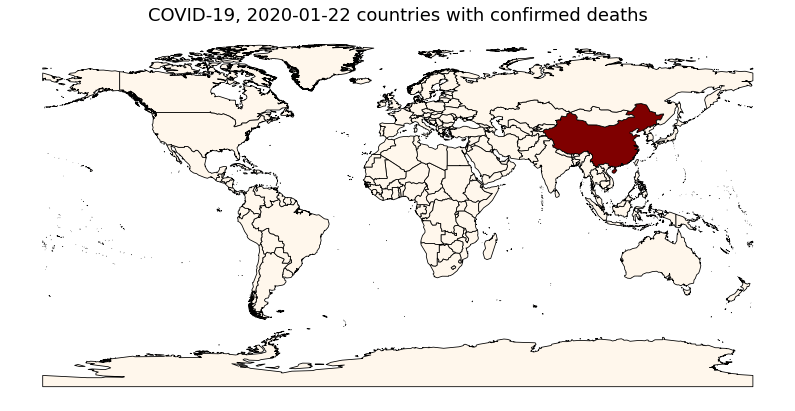

In [0]:
for day in range(0,90):
    data,key = get_dataset(day=day)
    data["isit"] = data[key] > 0
    fig, ax = plt.subplots(1, figsize=(14, 8))
    data.plot(column="isit", cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black', 
              vmin=0, vmax=1)
    
    ax.axis('off')
    ax.set_title('COVID-19, %s countries with confirmed deaths'%key, fontsize=18);
    pl.savefig("COVID-19-countireswdeath-%s.png"%key)
    pl.show()
    pl.close(fig)

In [0]:
!convert -loop -1 -delay 15 COVID-19-countireswdeath-*.png COVID-19-countireswdeath.gif

/bin/bash: convert: command not found


# COVID-19 intection analysis


In [0]:
# from the JHU database
infected = gpd.GeoDataFrame(pd.read_csv(root + 
                                        "time_series_19-covid-Confirmed.csv"))

In [0]:
infected = infected.groupby("Country/Region").sum()
# number of dates in the database
N = infected.shape[1] - 2

In [0]:
infected.reset_index(inplace=True)
infected["Country/Region"].replace("Mainland China", "China", inplace=True)
infected["Country/Region"].replace("UK", "United Kingdom", inplace=True)
infected["Country/Region"].replace("US", "United States", inplace=True)

In [0]:
infected.iloc[:,3:N+3]

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,4,4,5,7,7,7,11,16,21
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,10,12,23,33,38,42,51
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,3,5,12,12,17,17,19,20,20,20,24,26,37,48,54
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,2
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,4,8
152,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,6
153,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,10,17
154,0,2,2,2,2,2,2,2,2,2,6,6,8,8,8,10,10,13,13,14,15,15,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,18,30,30,31,38,39,47,53,56,61


In [0]:
infected["totalinfected"] = infected[infected.columns[-1]]
infected = addlogbydate(infected)

data, key = get_dataset(day=24, df=infected)
data = gpd.GeoDataFrame(data.groupby("NAME").sum().reset_index(
    ).merge(data[["NAME", "geometry"]].drop_duplicates(subset="NAME"), 
            on="NAME", how="left"))#.plot()


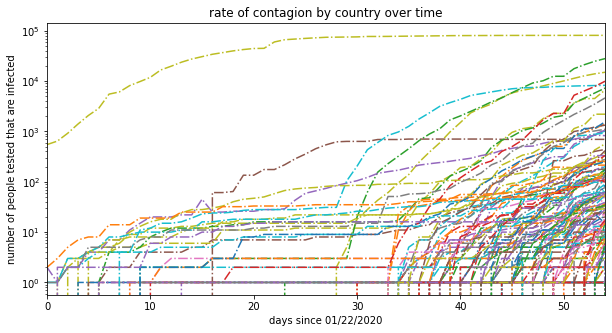

In [0]:
# the rate of contagion by country over time
def getcountry (df, country):
  return df[df["Country/Region"] == country].set_index("Country/Region")[
                  df.columns[3:N+3]].T.reset_index()

fig, ax = pl.subplots(1, 1, figsize=(10,5))
for country in infected["Country/Region"].values:

  tmp = getcountry(infected, country)#.set_index("Country/Region")
  tmp.plot(style="-.", 
           ax=ax, label=None,
           legend=False,
           #label=country, 
           figsize=(10,5))
pl.yscale("log")
pl.ylabel("number of people tested that are infected")
pl.xlabel("days since 01/22/2020")
pl.title("rate of contagion by country over time");

In [0]:
# combine with population data by country (using 2018 data from world bank)
df = infected.merge(pd.read_csv("data/pop.csv", skiprows=4)[[
                                                  "Country Name", "2018"]],
               left_on="Country/Region", right_on="Country Name")

In [0]:
output_notebook()

def bokeh_plot_ts(df, title='', p=None):
    """Plot bokeh map from GeoDF"""
    tmp = df.set_index("Country/Region")[df.columns[3:55]].T
    tmp["date"] = pd.to_datetime(tmp.index)
    tools = 'wheel_zoom,pan,reset,hover'
    if p is None: 
      p = figure(title=title,
                 plot_height=600, plot_width=600, 
               toolbar_location='right', tools=tools, 
               x_axis_type="datetime", y_axis_type="log")
    numlines = len(tmp.columns)
    mypalette = gray(numlines)
    colors = {}
    for i in range(numlines):
      colors[i] = mypalette[i]
    for i,(name, series) in enumerate(tmp.iteritems()):
      if name == 'date': continue
      name_for_display = np.tile(name, [len(tmp.index),1])

      source = ColumnDataSource({'x': tmp.date, 'y': series.values, 
              'series_name': name_for_display, 
              'Date': [tmp.date[i].strftime('%Y-%m-%d') for i in range(len(tmp))]})     
      p.line('x', 'y', source = source, line_alpha=0.3, line_width=3,
             line_color=colors[i], hover_line_alpha=1,)     

      hover = p.select(dict(type=HoverTool))
      hover.tooltips = [("Series", "@series_name"), 
                        ("Date", "@Date"),  
                        ("Value", "@y{0}"),]
      hover.mode = 'mouse'
    output_notebook()
    return p
tmp = infected.merge(#sort_values(by="totalinfected").merge(
    pd.read_csv("data/pop.csv", skiprows=4)[["Country Name", "2018"]],
               left_on="Country/Region", right_on="Country Name")

for i in range(len(tmp.index)):
  # normalize by population
  tmp.iloc[i, 3:N+3] = [0] + list(tmp.iloc[i,3+1:N+3].values - 
                                  tmp.iloc[i,3:N+2].values)
  tmp.iloc[i, 3:N+3] = tmp.iloc[i, 3:N+3].rolling(5, center=True,
                                                  min_periods=0).mean()
tmp
p = bokeh_plot_ts(tmp, title="daily rate of contagion (new cases) by country - " + 
                  "smoothed over a 5 days window"); 
show(p)

In [0]:
tmp = infected.merge(#sort_values(by="totalinfected").merge(
    pd.read_csv("data/pop.csv", skiprows=4)[["Country Name", "2018"]],
               left_on="Country/Region", right_on="Country Name")
tmp.head()

for i in range(len(tmp.index)):
  tmp.iloc[i, 3:N+3] = (np.array(tmp.iloc[i,3:N+3].values) / 
                        tmp.iloc[i]["2018"] * 1e6)
tmp
p = bokeh_plot_ts(tmp, title="infected per million people by country"); 
show(p)

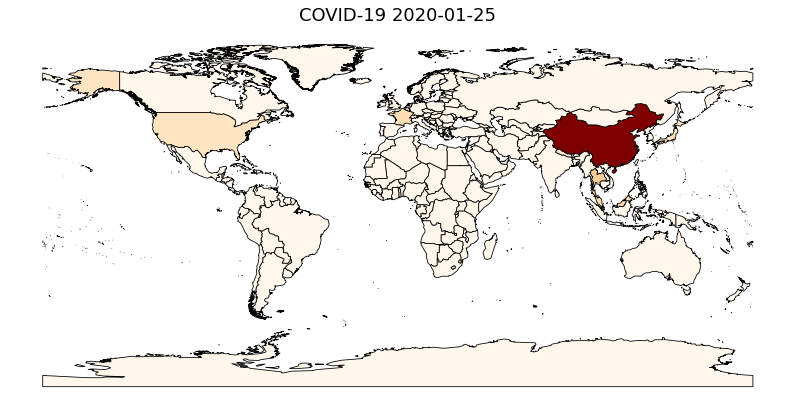

In [0]:
fig, ax = plt.subplots(1, figsize=(14, 8))
data.plot(column=key, 
          clim=(0,100), cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black')
ax.axis('off')
ax.set_title('COVID-19 %s'%key, fontsize=18);

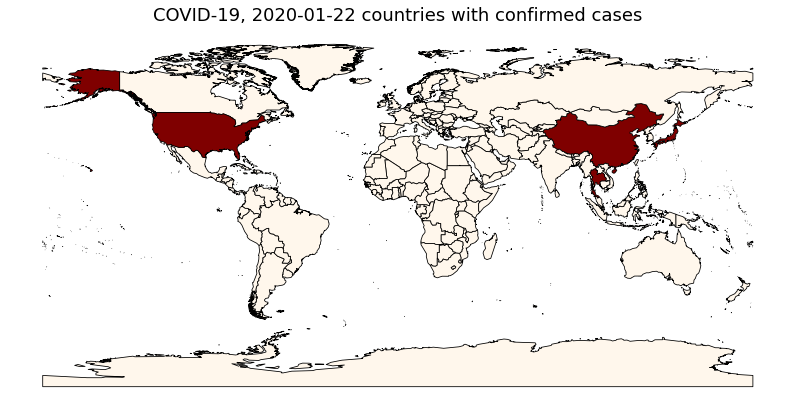

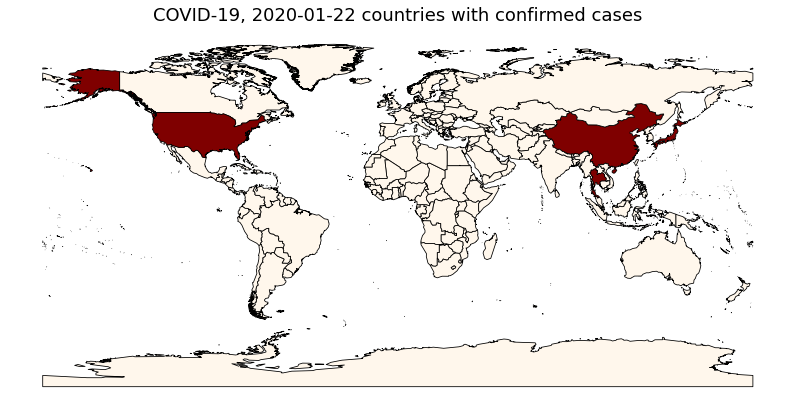

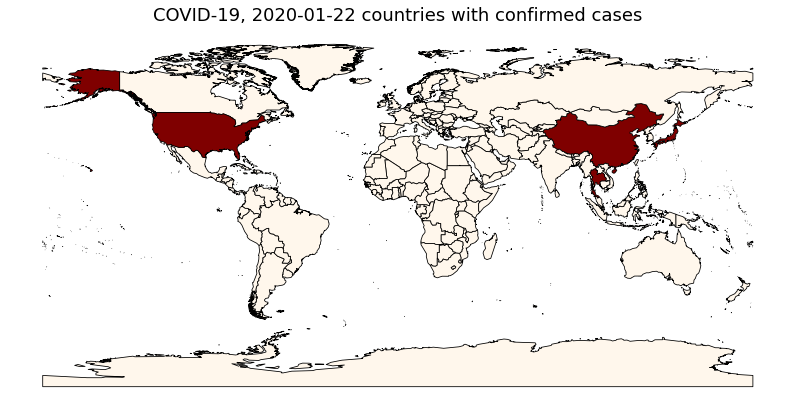

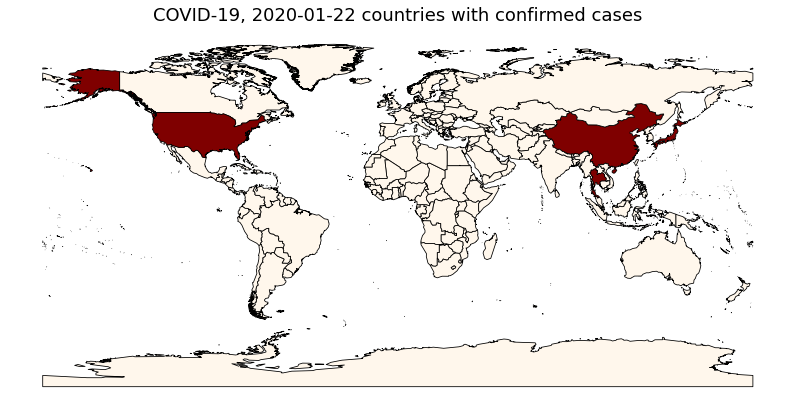

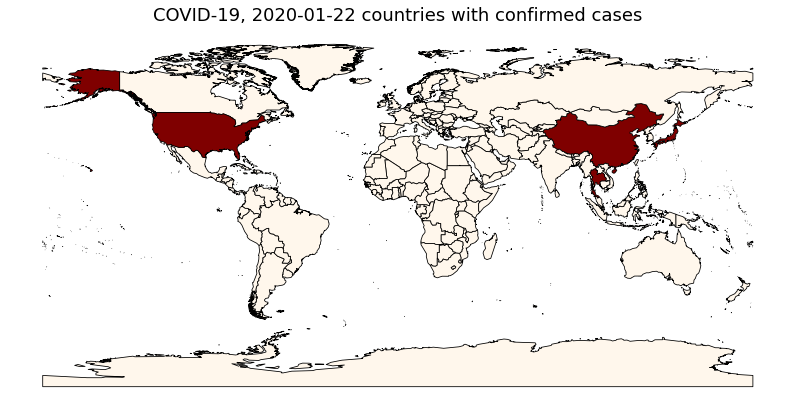

...

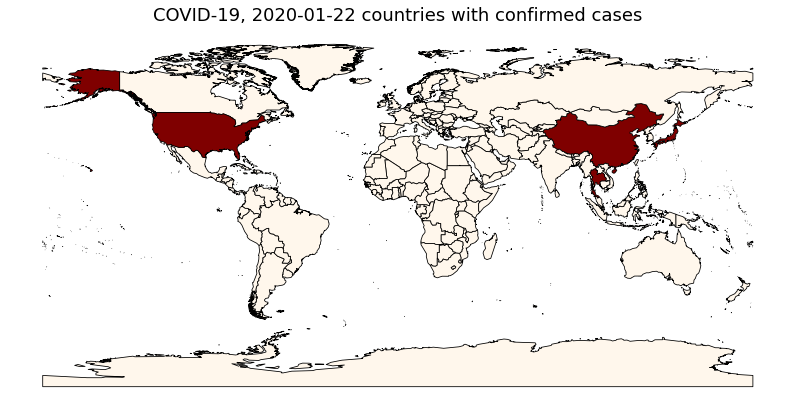

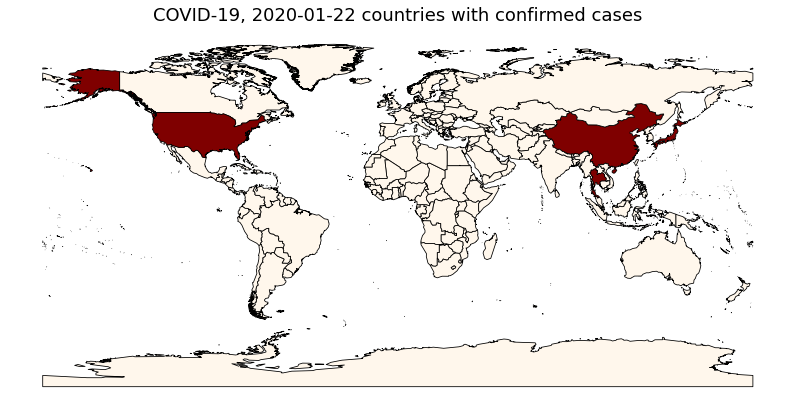

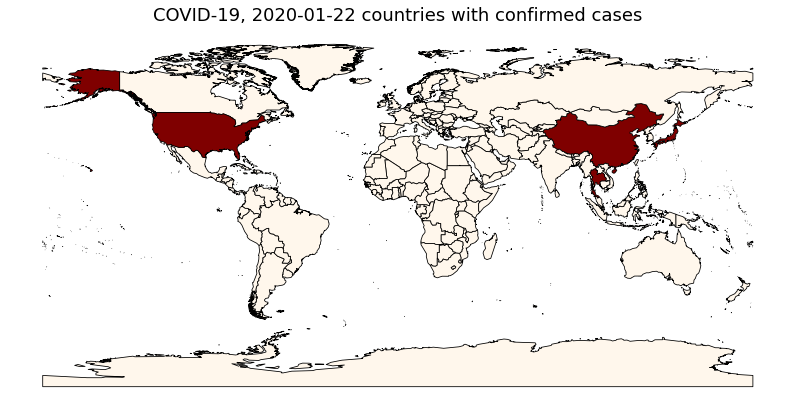

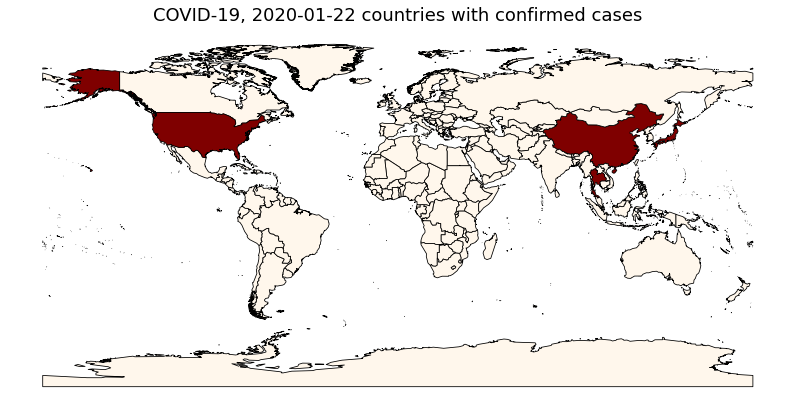

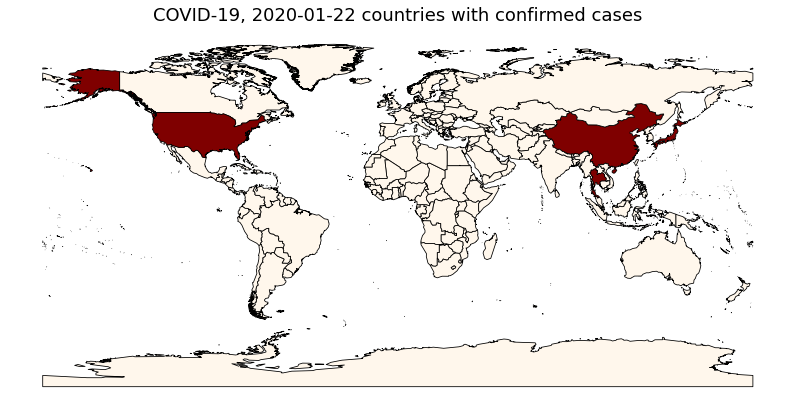

In [0]:
for day in range(0,90):
    data,key = get_dataset(day=day, df=infected)
    data["isit"] = data[key] > 0
    fig, ax = plt.subplots(1, figsize=(14, 8))
    data.plot(column="isit", cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black', 
              vmin=0, vmax=1)
    
    ax.axis('off')
    ax.set_title('COVID-19, %s countries with confirmed cases'%key, fontsize=18);
    pl.savefig("figs/COVID-19-contagion-%s.png"%key)
    pl.show()
    pl.close(fig)

# But the entire analysis is affected by the rate at which people are tested, and possibly by the test themselves: do all test kits have the same false positive and false negative rates?

# Adding number of tests by country

In [0]:
tests = pd.read_csv('data/covid-19-tests-country.csv')

In [0]:
tests = tests.replace("United States - CDC samples tested", "United States").replace(
    "China - Guangdong", "China").rename(
    {"Total COVID-19 tests performed (Tests)":"tests"}, axis=1)
tests

,Entity,Code,Year,tests
0,Armenia,ARM,14,211
1,Australia - Australian Capital Territory,NaN,18,649
2,Australia - New South Wales,NaN,13,8008
3,Austria,AUT,18,6582
4,Bahrain,BHR,17,9201
5,Canada - Alberta,NaN,17,4288
6,Canada - British Columbia,NaN,11,2008
7,Canada - Ontario,NaN,17,4185
8,China,NaN,0,320000
9,Croatia,HRV,14,344


out all the data together

In [0]:
infected["teninfected"] = [np.nan] * len(infected)
dates = []
for i,c in enumerate(infected.columns):
  if i > N+3:
    dates.append('')
    continue
  try: 
    dates.append(pd.to_datetime(c))
  except: 
    dates.append('') 
dates = np.array(dates)

In [0]:
for c in infected["Country/Region"]:
  for day in range(0, 90):
    data = pd.DataFrame(infected[infected["Country/Region"] == c].T)
    if data[dates == (pd.to_datetime("01/01/2020") + 
                      pd.Timedelta(day, unit="days"))].values > 10:
      infected.loc[infected["Country/Region"] == c, ["teninfected"]] = day
      break


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  """


,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,...,2020-02-07,2020-02-08,2020-02-09,2020-02-10,2020-02-11,2020-02-12,2020-02-13,2020-02-14,2020-02-15,2020-02-16,2020-02-17,2020-02-18,2020-02-19,2020-02-20,2020-02-21,2020-02-22,2020-02-23,2020-02-24,2020-02-25,2020-02-26,2020-02-27,2020-02-28,2020-02-29,2020-03-01,2020-03-02,2020-03-03,2020-03-04,2020-03-05,2020-03-06,2020-03-07,2020-03-08,2020-03-09,2020-03-10,2020-03-11,2020-03-12,2020-03-13,2020-03-14,2020-03-15,2020-03-16,teninfected
28,China,1083.3367,3684.4197,548,643,920,1406,2075,2877,5509,6087,8141,9802,11891,16630,19716,23707,27440,30587,34110,36814,39829,42354,44386,44759,59895,66358,68413,70513,72434,74211,74619,75077,75550,77001,77022,77241,77754,78166,78600,...,4.532894,4.566025,4.60021,4.626905,4.647256,4.65089,4.777398,4.8219,4.835145,4.848275,4.859948,4.870474,4.872855,4.875513,4.87824,4.886502,4.88662,4.887854,4.890728,4.893023,4.895428,4.897237,4.899585,4.902726,4.903833,4.90451,4.905186,4.906001,4.906825,4.907255,4.90754,4.907739,4.907884,4.908067,4.908126,4.908195,4.908367,4.908506,4.908667,21.0


In [0]:
infected["teninfected"]

0      73.0
1      70.0
2      63.0
3       NaN
4       NaN
       ... 
151     NaN
152     NaN
153    75.0
154    38.0
155     NaN
Name: teninfected, Length: 156, dtype: float64

In [0]:
wtests = world[["NAME", "geometry"]].merge((infected[["Country/Region",
                      "totalinfected", "teninfected"]].merge(tests, left_on="Country/Region", 
                                       right_on="Entity").merge(
              deaths[['Country/Region', 'Lat', 'Long',
        'totaldeaths', 'logtotaldeaths', 
        'firstoccurrence']], on="Country/Region")), how="left", 
        left_on="NAME",
        right_on="Country/Region").merge(pd.read_csv("data/pop.csv", 
                             skiprows=4)[["Country Name", "2017"]].rename(
                          {"2017":"pop"}, axis=1), left_on="Country/Region", 
                          right_on="Country Name")
print("number of countries with reported number of tests", wtests.shape[0])

number of countries with reported number of tests 26


In [0]:
# calculate tests per person and per million ppl, 
# death per 100,000 ppl, 
# ratio of dead to tested and infected to tested people
wtests["testspp"] = wtests["tests"] / wtests["pop"]
wtests["deathpM"] = wtests["totaldeaths"] / wtests["pop"] * 1e5
wtests["testspM"] = wtests["tests"] / wtests["pop"] * 1e3
wtests["dead2test"] = wtests["totaldeaths"] / wtests["tests"]
wtests["infected2test"] = wtests["totalinfected"] / wtests["tests"]
wtests["logtests"] = np.log(wtests["tests"] + 1)

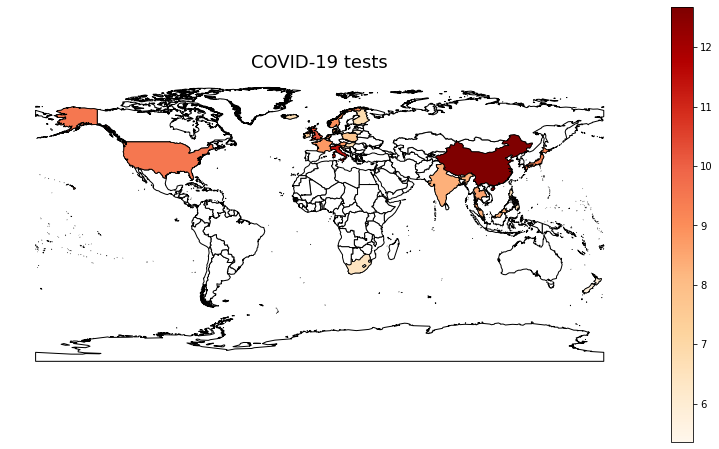

In [0]:
fig, ax = plt.subplots(1, figsize=(14, 8))
world.plot(ax=ax, edgecolor="k", facecolor="w")
wtests.fillna(0).plot(column="logtests", cmap="OrRd",
          linewidth=0.8, ax=ax, edgecolor='black',
          legend=True)
ax.axis('off')
ax.set_title('COVID-19 tests', fontsize=18);


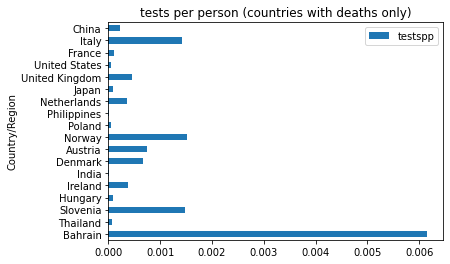

In [0]:
wtests[["testspp", "Country/Region", "totaldeaths"]][wtests.totaldeaths > 0
        ].sort_values(by="totaldeaths").set_index("Country/Region").plot(
            kind="barh", y="testspp");
pl.title("tests per person (countries with deaths only)");

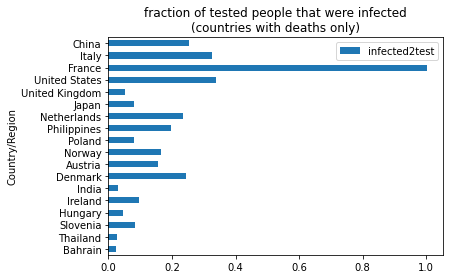

In [0]:
wtests[["infected2test", "Country/Region", "totaldeaths"]][wtests.totaldeaths > 0
        ].sort_values(by="totaldeaths").set_index("Country/Region").plot(
            kind="barh", y="infected2test")
pl.title("fraction of tested people that were infected\n" + 
         "(countries with deaths only)");        

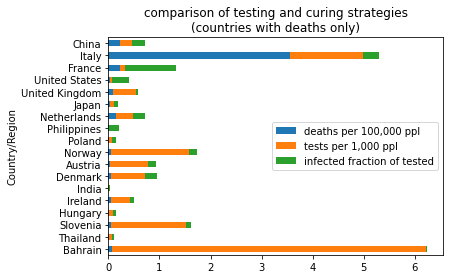

In [0]:
wtests[wtests.totaldeaths > 0
        ].sort_values(by="totaldeaths").set_index("Country/Region")[[
     "deathpM", "testspM", "infected2test"]].rename({"deathpM":
                                                     "deaths per 100,000 ppl", 
                            "infected2test":"infected fraction of tested", 
                            "testspM":"tests per 1,000 ppl"}, axis=1
         
     ).plot(kind="barh", stacked=True)
pl.title("comparison of testing and curing strategies\n" +
         "(countries with deaths only)");        

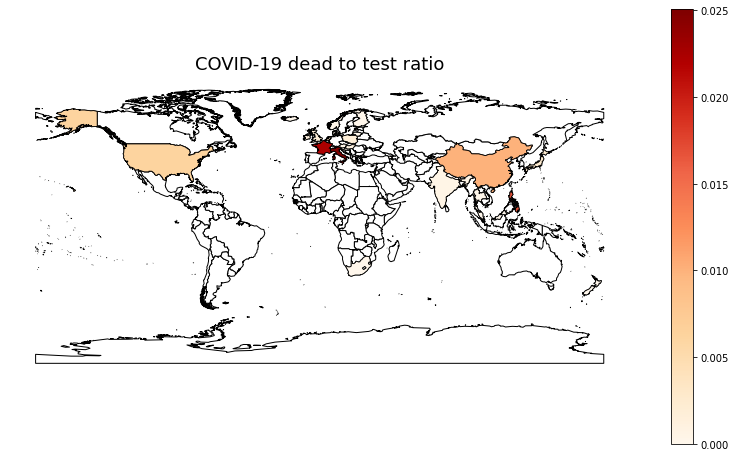

In [0]:
fig, ax = plt.subplots(1, figsize=(14, 8))
world.plot(ax=ax, edgecolor="k", facecolor="w")
wtests.fillna(0).plot(column="dead2test", cmap="OrRd",
          linewidth=0.8, ax=ax, edgecolor='black',
          legend=True)
ax.axis('off')
ax.set_title('COVID-19 dead to test ratio', fontsize=18);


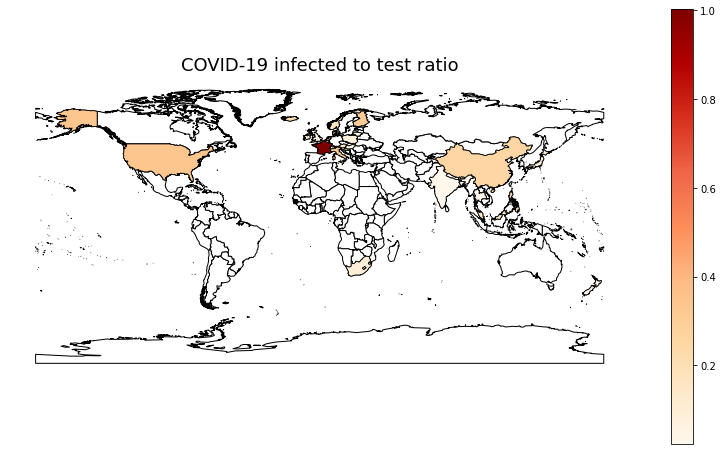

In [0]:
fig, ax = plt.subplots(1, figsize=(14, 8))
world.plot(ax=ax, edgecolor="k", facecolor="w")
wtests.fillna(0).plot(column="infected2test", cmap="OrRd",
          linewidth=0.8, ax=ax, edgecolor='black',
          legend=True)
ax.axis('off')
ax.set_title('COVID-19 infected to test ratio', fontsize=18);


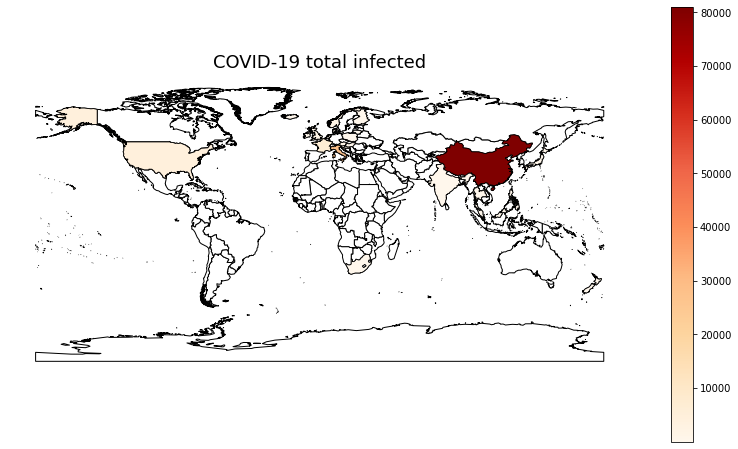

In [0]:
fig, ax = plt.subplots(1, figsize=(14, 8))
world.plot(ax=ax, edgecolor="k", facecolor="w")
wtests.fillna(0).plot(column="totalinfected", cmap="OrRd",
          linewidth=0.8, ax=ax, edgecolor='black',
          legend=True)
ax.axis('off')
ax.set_title('COVID-19 total infected', fontsize=18);


In [0]:
wtests.set_index("NAME", inplace=True)

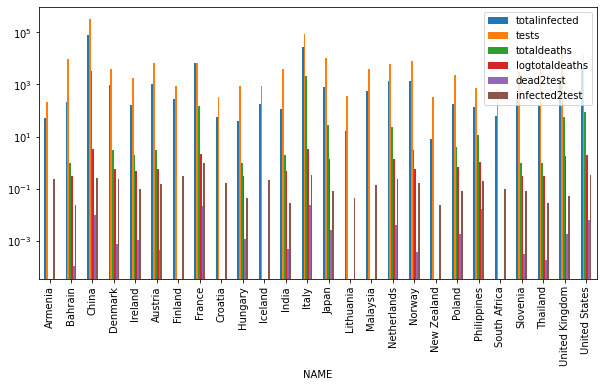

In [0]:
wtests[['totalinfected', 'tests', 'totaldeaths', 'logtotaldeaths',
       'dead2test', 'infected2test']][wtests.totalinfected > 0].plot(kind='bar',
                            figsize=(10, 5))
pl.yscale('log')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()


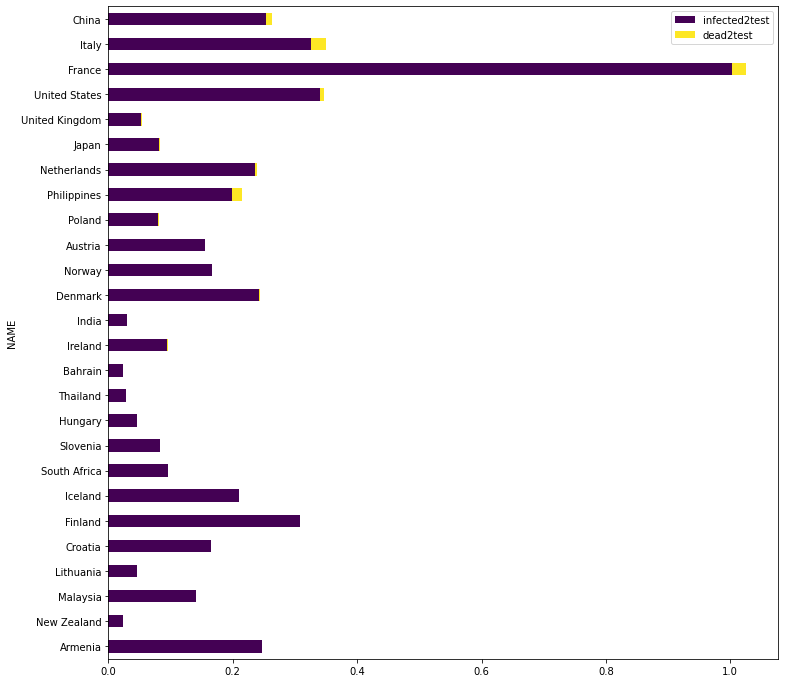

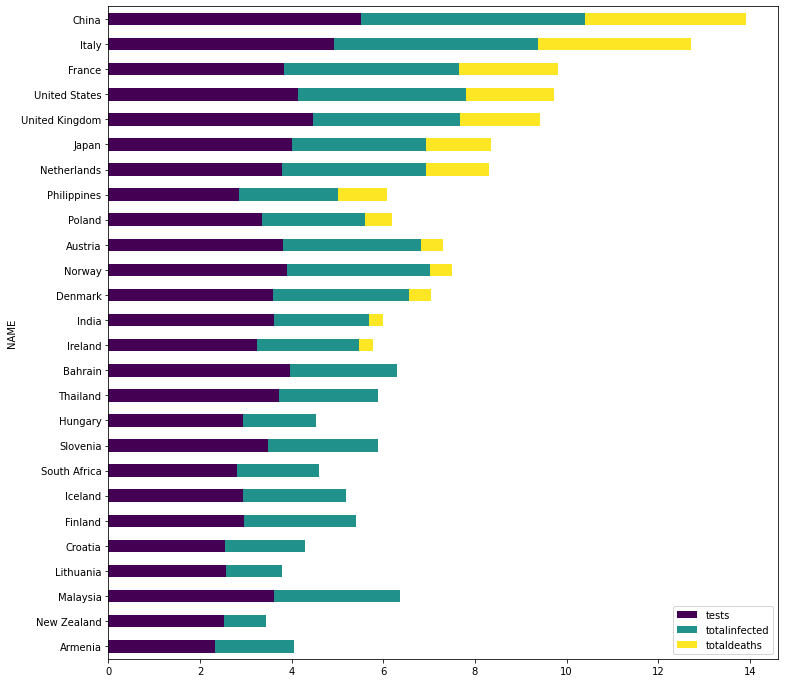

In [0]:
wtestsnormed = wtests[['tests', 
                       'totalinfected', 'totaldeaths',
                       'infected2test', 'dead2test', "teninfected"
       ]][wtests.totalinfected > 0].sort_values(by="totaldeaths", ascending=True)

wtestsnormed[[ 'infected2test', 'dead2test']].plot(kind='barh', 
                                figsize=(12, 12), stacked=True, 
                  cmap='viridis')

np.log10(wtestsnormed[['tests', 
                       'totalinfected', 'totaldeaths']]).plot(kind='barh', 
                                figsize=(12, 12), stacked=True, 
                  cmap='viridis');

In [0]:
wtestsnormed

,tests,totalinfected,totaldeaths,infected2test,dead2test,teninfected
NAME,,,,,,
Armenia,211.0,52.0,0.0,0.246445,0.000000,73.0
New Zealand,338.0,8.0,0.0,0.023669,0.000000,NaN
Malaysia,4010.0,566.0,0.0,0.141147,0.000000,35.0
Lithuania,366.0,17.0,0.0,0.046448,0.000000,74.0
Croatia,344.0,57.0,0.0,0.165698,0.000000,65.0
Finland,900.0,277.0,0.0,0.307778,0.000000,64.0
Iceland,856.0,180.0,0.0,0.210280,0.000000,62.0
South Africa,645.0,62.0,0.0,0.096124,0.000000,70.0
Slovenia,3058.0,253.0,1.0,0.082734,0.000327,67.0


In [0]:
socioec = pd.read_csv("data/gdp.csv", 
                      skiprows=4)[["Country Name", "2017"]].rename(
                          {"2017":"gdp"}, axis=1).merge(
                          pd.read_csv("data/pop.csv", 
                             skiprows=4)[["Country Name", "2017"]].rename(
                          {"2017":"pop"}, axis=1)).merge(
                          pd.read_csv("data/pop.csv",skiprows=4)[[
                          "Country Name", "2017"]].rename(
                          {"2017":"growth"}, axis=1)).merge(
                          pd.read_csv("data/land.csv",skiprows=4)[[
                          "Country Name", "2017"]].rename(
                          {"2017":"land"}, axis=1)).merge(
                          pd.read_csv("data/urban.csv",skiprows=4)[[
                          "Country Name", "2010"]].rename(
                          {"2010":"urban"}, axis=1)).merge(
                          pd.read_csv("data/age.csv",skiprows=4)[[
                          "Country Name", "2018"]].rename(
                          {"2018":"age"}, axis=1)).fillna(0)
socioec

,Country Name,gdp,pop,growth,land,urban,age
0,Aruba,2.700559e+09,105366.0,105366.0,180.0,172.847748,13.550947
1,Afghanistan,2.019176e+10,36296400.0,36296400.0,652860.0,0.000000,2.584927
2,Angola,1.221238e+11,29816748.0,29816748.0,1246700.0,1427.029541,2.216374
3,Albania,1.302506e+10,2873457.0,2873457.0,27400.0,1689.403809,13.744736
4,Andorra,3.013387e+09,77001.0,77001.0,470.0,0.000000,0.000000
...,...,...,...,...,...,...,...
259,Kosovo,7.227700e+09,1830700.0,1830700.0,10887.0,0.000000,0.000000
260,"Yemen, Rep.",2.681870e+10,27834821.0,27834821.0,527970.0,4703.399902,2.876270
261,South Africa,3.495541e+11,57000451.0,57000451.0,1213090.0,53460.312500,5.318005
262,Zambia,2.586814e+10,16853688.0,16853688.0,743390.0,0.000000,2.099678


In [0]:
# for the urban fraction of population, the 2010 data is more complete
pd.read_csv("data/urban.csv",skiprows=4)[["2010"]]

,2010
0,172.847748
1,NaN
2,1427.029541
3,1689.403809
4,NaN
...,...
259,NaN
260,4703.399902
261,53460.312500
262,NaN


In [0]:
formodeling = wtestsnormed.merge(socioec, left_index=True, right_on="Country Name")
formodeling.head()

,tests,totalinfected,totaldeaths,infected2test,dead2test,teninfected,Country Name,gdp,pop,growth,land,urban,age
8,211.0,52.0,0.0,0.246445,0.0,73.0,Armenia,1.152746e+10,2944809.0,2944809.0,28470.000000,0.000000,11.253818
178,338.0,8.0,0.0,0.023669,0.0,NaN,New Zealand,2.025908e+11,4793900.0,4793900.0,263310.000000,8116.299805,15.652425
167,4010.0,566.0,0.0,0.141147,0.0,35.0,Malaysia,3.189582e+11,31105028.0,31105028.0,328550.000000,15564.952150,6.671755
141,366.0,17.0,0.0,0.046448,0.0,74.0,Lithuania,4.763296e+10,2828403.0,2828403.0,62642.001953,4610.856445,19.705033
97,344.0,57.0,0.0,0.165698,0.0,65.0,Croatia,5.531962e+10,4124531.0,4124531.0,55960.000000,5302.795898,20.445433


In [0]:
formodeling["testpp"] = formodeling["tests"] / formodeling["pop"]
#formodeling["totaldeaths"] = formodeling["test"] / formodeling["pop"]
#formodeling["testpp"] = formodeling["test"] / formodeling["pop"]
formodeling.reset_index(inplace=True)

cannot predict the numner of tests from socioeconomics at all. R~0.2

In [0]:
import statsmodels.formula.api as smf
testpp = smf.ols(formula="testpp ~ gdp + pop + growth + " + 
                 "land + urban + age", data=formodeling).fit()
testpp.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 testpp   R-squared:                       0.185
Model:                            OLS   Adj. R-squared:                 -0.019
Method:                 Least Squares   F-statistic:                    0.9051
Date:                Tue, 17 Mar 2020   Prob (F-statistic):              0.497
Time:                        16:38:23   Log-Likelihood:                 139.39
No. Observations:                  26   AIC:                            -266.8
Df Residuals:                      20   BIC:                            -259.2
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.0023      0.001      2.679      0.014       0.001       0.004
gdp         3.791e-16   3.83e-16      0.991      0.334   -4.19e-16    1.18e-15
pop         3.007e-11   1.13e-11      2.657      0.015    6.46e-12    5.37e-11
growth     -3.038e-11   1.13e-11     -2.692      0.014   -5.39e-11   -6.84e-12
land        -3.05e-10   4.79e-10     -0.637      0.532    -1.3e-09    6.94e-10
urban      -6.547e-09   7.51e-09     -0.872      0.394   -2.22e-08    9.11e-09
age           -0.0001   5.37e-05     -1.880      0.075      -0.000     1.1e-05
==============================================================================
Omnibus:                       20.543   Durbin-Watson:                   2.297
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               29.975
Skew:                           1.685   Prob(JB):                     3.10e-07
Kurtosis:                       7.038   Cond. No.                     7.10e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.15e-15. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

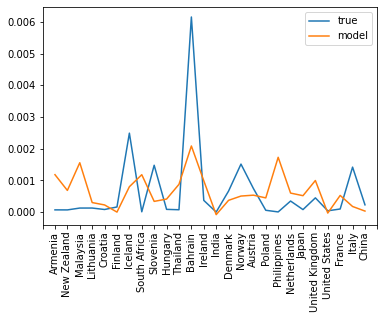

In [0]:
ax = formodeling[["testpp"]].plot(y="testpp",
                                  label="true")
pl.plot(testpp.predict(), label="model")
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + 
                   list(formodeling["Country Name"].values), rotation=90);
pl.legend();

The total number of infected individuals can be predicted to R~0.9 with dgb, land area, and urban fraction strong correlations. Urban fraction is again inversely proportional, but it improves the fit from 65 to 90%

In [0]:
totalinfected = smf.ols(formula="totalinfected ~ gdp +	pop	+ growth + " + 
                        "land	+ age", data=formodeling).fit()
totalinfected.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          totalinfected   R-squared:                       0.630
Model:                            OLS   Adj. R-squared:                  0.560
Method:                 Least Squares   F-statistic:                     8.945
Date:                Tue, 17 Mar 2020   Prob (F-statistic):           0.000222
Time:                        16:38:26   Log-Likelihood:                -275.88
No. Observations:                  26   AIC:                             561.8
Df Residuals:                      21   BIC:                             568.1
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept  -1.328e+04   6879.319     -1.931      0.067   -2.76e+04    1022.331
gdp        -4.618e-09   1.91e-09     -2.418      0.025   -8.59e-09   -6.47e-10
pop           -0.0003      0.000     -1.913      0.069      -0.001    2.18e-05
growth         0.0003      0.000      1.947      0.065   -1.74e-05       0.001
land           0.0118      0.004      2.944      0.008       0.003       0.020
age          930.4966    421.915      2.205      0.039      53.076    1807.917
==============================================================================
Omnibus:                        4.618   Durbin-Watson:                   1.229
Prob(Omnibus):                  0.099   Jarque-Bera (JB):                2.853
Skew:                           0.567   Prob(JB):                        0.240
Kurtosis:                       4.162   Cond. No.                     6.16e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.52e-15. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [0]:
totalinfected = smf.ols(formula="totalinfected ~ gdp +	pop	+ growth + " + 
                        "land	+ urban + age", data=formodeling).fit()
totalinfected.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          totalinfected   R-squared:                       0.852
Model:                            OLS   Adj. R-squared:                  0.815
Method:                 Least Squares   F-statistic:                     22.98
Date:                Tue, 17 Mar 2020   Prob (F-statistic):           1.17e-07
Time:                        16:38:27   Log-Likelihood:                -264.00
No. Observations:                  26   AIC:                             540.0
Df Residuals:                      20   BIC:                             547.5
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept  -4478.9290   4744.893     -0.944      0.356   -1.44e+04    5418.745
gdp         4.606e-09   2.09e-09      2.200      0.040    2.39e-10    8.97e-09
pop        -5.357e-05   6.19e-05     -0.865      0.397      -0.000    7.56e-05
growth      6.302e-05   6.17e-05      1.021      0.320   -6.58e-05       0.000
land           0.0102      0.003      3.888      0.001       0.005       0.016
urban         -0.2246      0.041     -5.467      0.000      -0.310      -0.139
age          347.9866    293.738      1.185      0.250    -264.739     960.712
==============================================================================
Omnibus:                       50.456   Durbin-Watson:                   1.434
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              271.118
Skew:                           3.634   Prob(JB):                     1.34e-59
Kurtosis:                      17.052   Cond. No.                     7.10e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.15e-15. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

the total number of deaths is actually predicted farily well by the land area, and urban area, but it is inversely proportional to the urban area. The data on urban area is likely strongly based. Adding the tests per person does not improve the fit. GDP is mildely predictive. Adding the total number of infected people makes the death prediction ~90% accurate with **Italy being a strong outlier**

In [0]:
totaldeaths = smf.ols(formula="totaldeaths ~ gdp +	pop	+ growth	+ " + 
                      "land	+ urban + age", data=formodeling).fit()
totaldeaths.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            totaldeaths   R-squared:                       0.637
Model:                            OLS   Adj. R-squared:                  0.546
Method:                 Least Squares   F-statistic:                     7.020
Date:                Tue, 17 Mar 2020   Prob (F-statistic):           0.000618
Time:                        16:38:28   Log-Likelihood:                -195.06
No. Observations:                  26   AIC:                             402.1
Df Residuals:                      20   BIC:                             409.7
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   -268.3709    334.668     -0.802      0.432    -966.476     429.734
gdp         1.775e-10   1.48e-10      1.202      0.243    -1.3e-10    4.85e-10
pop        -3.253e-06   4.37e-06     -0.745      0.465   -1.24e-05    5.86e-06
growth      3.734e-06   4.36e-06      0.857      0.401   -5.35e-06    1.28e-05
land           0.0004      0.000      2.047      0.054    -7.2e-06       0.001
urban         -0.0086      0.003     -2.976      0.007      -0.015      -0.003
age           21.1647     20.718      1.022      0.319     -22.052      64.382
==============================================================================
Omnibus:                       56.479   Durbin-Watson:                   1.713
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              384.549
Skew:                           4.118   Prob(JB):                     3.14e-84
Kurtosis:                      19.945   Cond. No.                     7.10e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.15e-15. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [0]:
# the number of tested people per capita actually does not improve the fit
totaldeaths = smf.ols(formula="totaldeaths ~ gdp +	pop	+ growth	+ " + 
                      "land	+ urban + age + testpp", data=formodeling).fit()
totaldeaths.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            totaldeaths   R-squared:                       0.637
Model:                            OLS   Adj. R-squared:                  0.546
Method:                 Least Squares   F-statistic:                     7.020
Date:                Tue, 17 Mar 2020   Prob (F-statistic):           0.000618
Time:                        16:38:29   Log-Likelihood:                -195.06
No. Observations:                  26   AIC:                             402.1
Df Residuals:                      20   BIC:                             409.7
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   -268.3661    334.666     -0.802      0.432    -966.467     429.735
gdp         1.775e-10   1.48e-10      1.202      0.243    -1.3e-10    4.85e-10
pop        -3.252e-06   4.37e-06     -0.745      0.465   -1.24e-05    5.86e-06
growth      3.733e-06   4.35e-06      0.857      0.401   -5.35e-06    1.28e-05
land           0.0004      0.000      2.047      0.054   -7.21e-06       0.001
urban         -0.0086      0.003     -2.976      0.007      -0.015      -0.003
age           21.1645     20.718      1.022      0.319     -22.052      64.381
testpp        -0.6258      0.780     -0.803      0.432      -2.252       1.001
==============================================================================
Omnibus:                       56.479   Durbin-Watson:                   1.713
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              384.550
Skew:                           4.118   Prob(JB):                     3.13e-84
Kurtosis:                      19.945   Cond. No.                     7.14e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.13e-15. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [0]:
formodeling["teninfected"].fillna(maxday.days, inplace=True)

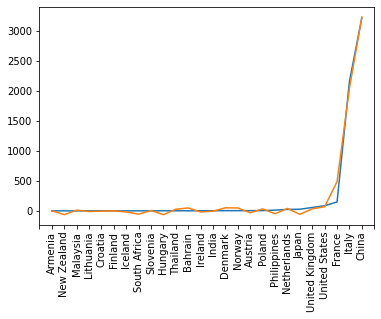

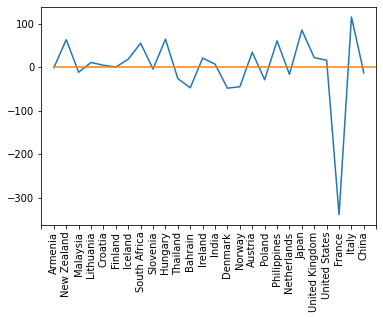

In [0]:
import numpy as np
ax = formodeling["totaldeaths"].plot()
pl.plot(totaldeaths.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.figure()
ax = (formodeling["totaldeaths"] - totaldeaths.predict()).plot()
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0]);

In [0]:
totaldeaths = smf.ols(formula="totaldeaths ~ gdp + " + 
                          " testpp + "
                      "pop	+ growth	+ land	+ urban + age + totalinfected", 
                      data=formodeling).fit()
totaldeaths.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            totaldeaths   R-squared:                       0.988
Model:                            OLS   Adj. R-squared:                  0.985
Method:                 Least Squares   F-statistic:                     266.1
Date:                Tue, 17 Mar 2020   Prob (F-statistic):           2.76e-17
Time:                        16:41:57   Log-Likelihood:                -150.47
No. Observations:                  26   AIC:                             314.9
Df Residuals:                      19   BIC:                             323.8
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept        42.3768     63.171      0.671      0.510     -89.842     174.595
gdp           -1.421e-10   3.04e-11     -4.674      0.000   -2.06e-10   -7.84e-11
testpp            0.1080      0.161      0.671      0.510      -0.229       0.445
pop            -1.83e-06    2.6e-06     -0.705      0.490   -7.27e-06    3.61e-06
growth         1.655e-06   2.59e-06      0.638      0.531   -3.77e-06    7.08e-06
land             -0.0003   4.52e-05     -7.262      0.000      -0.000      -0.000
urban             0.0070      0.001      8.236      0.000       0.005       0.009
age              -2.9786      3.958     -0.752      0.461     -11.263       5.306
totalinfected     0.0694      0.003     23.819      0.000       0.063       0.075
==============================================================================
Omnibus:                       40.172   Durbin-Watson:                   2.620
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              151.306
Skew:                          -2.827   Prob(JB):                     1.39e-33
Kurtosis:                      13.378   Cond. No.                     5.63e+19
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.82e-13. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [0]:
logtotaldeaths1 = smf.ols(formula="np.log10(totaldeaths +1)~ gdp + " + 
                          " testpp + "
                      "pop	+ growth	+ land	+ urban + age + totalinfected", 
                      data=formodeling).fit()
logtotaldeaths1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                OLS Regression Results                               
=====================================================================================
Dep. Variable:     np.log10(totaldeaths + 1)   R-squared:                       0.891
Model:                                   OLS   Adj. R-squared:                  0.857
Method:                        Least Squares   F-statistic:                     26.01
Date:                       Tue, 17 Mar 2020   Prob (F-statistic):           3.38e-08
Time:                               16:41:58   Log-Likelihood:                -7.5932
No. Observations:                         26   AIC:                             29.19
Df Residuals:                             19   BIC:                             37.99
Df Model:                                  6                                         
Covariance Type:                   nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept         0.6757      0.259      2.605      0.017       0.133       1.219
gdp            2.183e-13   1.25e-13      1.750      0.096   -4.29e-14    4.79e-13
testpp            0.0017      0.001      2.601      0.018       0.000       0.003
pop            -2.74e-08   1.07e-08     -2.569      0.019   -4.97e-08   -5.08e-09
growth         2.796e-08   1.06e-08      2.626      0.017    5.67e-09    5.03e-08
land          -1.149e-06   1.86e-07     -6.185      0.000   -1.54e-06    -7.6e-07
urban          9.034e-06   3.47e-06      2.604      0.017    1.77e-06    1.63e-05
age              -0.0184      0.016     -1.130      0.273      -0.052       0.016
totalinfected  8.594e-05    1.2e-05      7.186      0.000    6.09e-05       0.000
==============================================================================
Omnibus:                        1.411   Durbin-Watson:                   1.503
Prob(Omnibus):                  0.494   Jarque-Bera (JB):                1.302
Skew:                           0.469   Prob(JB):                        0.522
Kurtosis:                       2.434   Cond. No.                     5.63e+19
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.82e-13. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

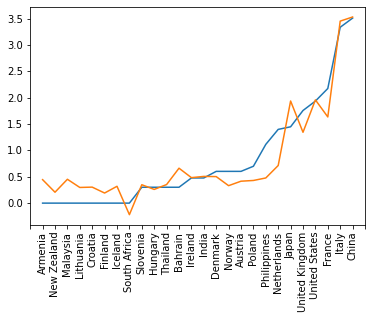

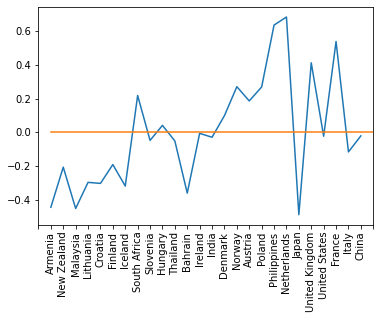

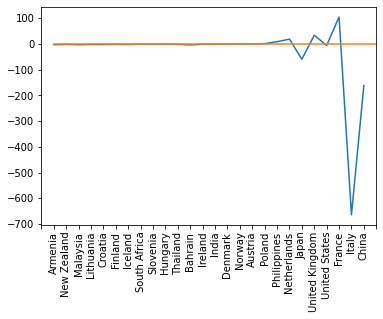

In [0]:
ax = np.log10(formodeling["totaldeaths"] + 1).plot()
pl.plot(totaldeaths1.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.figure()
ax = (np.log10(formodeling["totaldeaths"] + 1) - logtotaldeaths1.predict()).plot()
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0]);
pl.figure()
ax = ((formodeling["totaldeaths"]) - 10**logtotaldeaths1.predict()).plot()
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0]);

In [0]:
totaldeaths2 = smf.ols(formula="totaldeaths ~ gdp + " + 
                      "pop	+ growth	+ land	+ urban + age + totalinfected +"
                      "testpp + teninfected", 
                      data=formodeling).fit()
totaldeaths2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            totaldeaths   R-squared:                       0.990
Model:                            OLS   Adj. R-squared:                  0.986
Method:                 Least Squares   F-statistic:                     249.0
Date:                Tue, 17 Mar 2020   Prob (F-statistic):           1.35e-16
Time:                        16:42:01   Log-Likelihood:                -148.65
No. Observations:                  26   AIC:                             313.3
Df Residuals:                      18   BIC:                             323.4
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept       -99.8618    105.403     -0.947      0.356    -321.304     121.581
gdp           -1.172e-10   3.28e-11     -3.573      0.002   -1.86e-10   -4.83e-11
pop           -1.639e-06   1.65e-06     -0.995      0.333    -5.1e-06    1.82e-06
growth         1.498e-06   1.67e-06      0.899      0.380      -2e-06       5e-06
land             -0.0004   4.66e-05     -7.657      0.000      -0.000      -0.000
urban             0.0068      0.001      8.277      0.000       0.005       0.008
age              -4.9321      3.972     -1.242      0.230     -13.277       3.413
totalinfected     0.0705      0.003     24.541      0.000       0.064       0.077
testpp           -0.2190      0.232     -0.944      0.358      -0.706       0.268
teninfected       2.7748      1.684      1.648      0.117      -0.763       6.312
==============================================================================
Omnibus:                       35.317   Durbin-Watson:                   2.566
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              110.066
Skew:                          -2.491   Prob(JB):                     1.26e-24
Kurtosis:                      11.763   Cond. No.                     7.92e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 9.2e-16. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

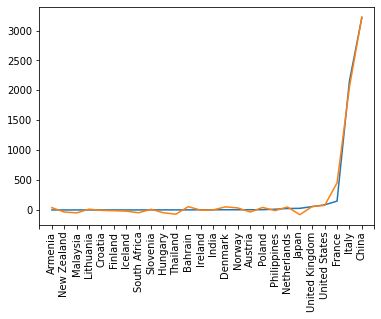

<Figure size 432x288 with 0 Axes>

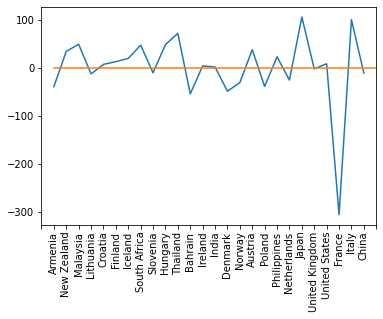

In [0]:
ax = formodeling["totaldeaths"].plot()
pl.plot(totaldeaths2.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.figure()
pl.figure()
ax = ((formodeling["totaldeaths"]) - totaldeaths2.predict()).plot()
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0]);

In [0]:
logtotaldeaths2 = smf.ols(formula="np.log10(totaldeaths + 1) ~ gdp + " + 
                      "pop	+ growth	+ land	+ urban + age + totalinfected +"
                      "testpp + teninfected", 
                      data=formodeling).fit()
totaldeaths2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            totaldeaths   R-squared:                       0.990
Model:                            OLS   Adj. R-squared:                  0.986
Method:                 Least Squares   F-statistic:                     249.0
Date:                Tue, 17 Mar 2020   Prob (F-statistic):           1.35e-16
Time:                        16:42:01   Log-Likelihood:                -148.65
No. Observations:                  26   AIC:                             313.3
Df Residuals:                      18   BIC:                             323.4
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept       -99.8618    105.403     -0.947      0.356    -321.304     121.581
gdp           -1.172e-10   3.28e-11     -3.573      0.002   -1.86e-10   -4.83e-11
pop           -1.639e-06   1.65e-06     -0.995      0.333    -5.1e-06    1.82e-06
growth         1.498e-06   1.67e-06      0.899      0.380      -2e-06       5e-06
land             -0.0004   4.66e-05     -7.657      0.000      -0.000      -0.000
urban             0.0068      0.001      8.277      0.000       0.005       0.008
age              -4.9321      3.972     -1.242      0.230     -13.277       3.413
totalinfected     0.0705      0.003     24.541      0.000       0.064       0.077
testpp           -0.2190      0.232     -0.944      0.358      -0.706       0.268
teninfected       2.7748      1.684      1.648      0.117      -0.763       6.312
==============================================================================
Omnibus:                       35.317   Durbin-Watson:                   2.566
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              110.066
Skew:                          -2.491   Prob(JB):                     1.26e-24
Kurtosis:                      11.763   Cond. No.                     7.92e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 9.2e-16. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

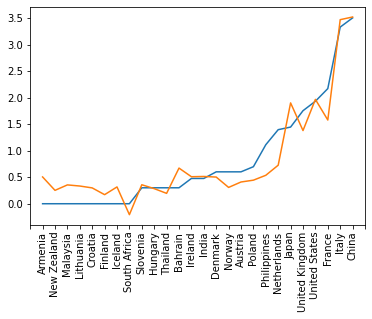

<Figure size 432x288 with 0 Axes>

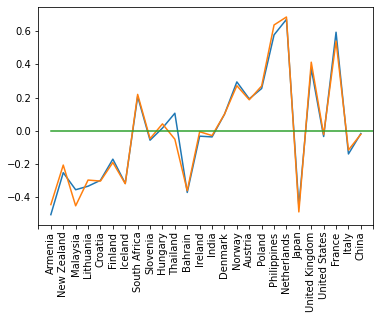

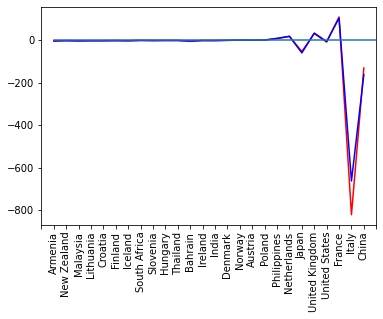

In [0]:
ax = np.log10(formodeling["totaldeaths"] + 1).plot()
pl.plot(logtotaldeaths2.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.figure()
pl.figure()
ax = (np.log10(formodeling["totaldeaths"] + 1) - logtotaldeaths2.predict()).plot()
(np.log10(formodeling["totaldeaths"] + 1) - logtotaldeaths1.predict()).plot(ax=ax)
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0]);
pl.figure()
ax = (formodeling["totaldeaths"] - 10**logtotaldeaths2.predict()).plot(c='r')
(formodeling["totaldeaths"] - 10**logtotaldeaths1.predict()).plot(ax=ax, c='b')
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0]);

In [0]:
import sklearn
from sklearn import ensemble
from sklearn.ensemble import RandomForestRegressor
RandomForestRegressor
y = np.log10(formodeling[["totaldeaths"]] + 1)
features = ["gdp","pop","growth","land","urban","age","totalinfected",
                "testpp","teninfected"]
X = formodeling[features]
regr = RandomForestRegressor(max_depth=4, random_state=0)
regr.fit(X, y)
print(regr.feature_importances_);
print(regr.predict(X));

[0.16497833 0.01636786 0.01884475 0.01210031 0.07058925 0.02456615
 0.58079145 0.02255992 0.08920198]
[0.12074383 0.06075204 0.35188583 0.07207615 0.07236939 0.10533091
 0.16029591 0.29578562 0.26148745 0.16243455 0.55015851 0.36767882
 0.38717557 0.86204674 0.54431144 0.78157174 0.60660986 0.51969701
 0.78641047 1.17381494 1.22943783 1.59301909 1.96857197 2.04990056
 2.75320547 3.09619696]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


In [0]:
regr.score(X, y)

0.9466250293537058

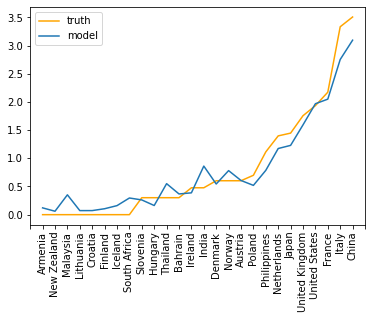

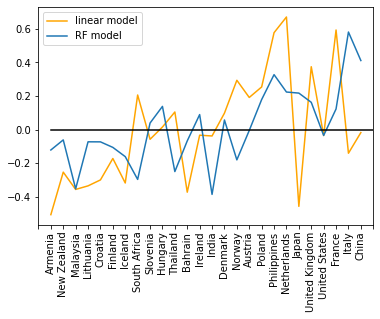

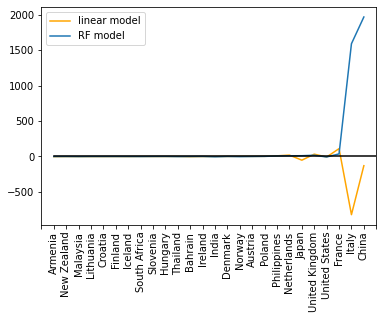

In [0]:
ax = np.log10(formodeling["totaldeaths"] + 1).plot(label="truth", c="orange")
pl.plot(regr.predict(X), label="model")
pl.legend()
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.figure()

ax = (np.log10(formodeling["totaldeaths"] + 1) - 
      logtotaldeaths2.predict()).plot(label="linear model", c="orange")
(np.log10(formodeling["totaldeaths"] + 1) - 
 regr.predict(X)).plot(ax=ax, label="RF model")
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0], color='k');
pl.legend()

pl.figure()
ax = (formodeling["totaldeaths"] - 
      10**logtotaldeaths2.predict()).plot(label="linear model", c="orange")
(formodeling["totaldeaths"] - 
 10**regr.predict(X)).plot(ax=ax, label="RF model")
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0], color='k');
pl.legend()


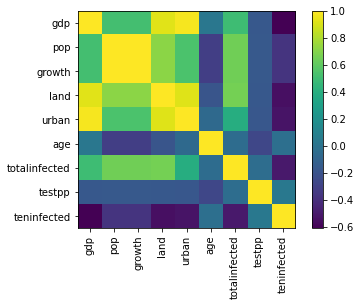

In [0]:
covMatrix = np.corrcoef(X.T)
pl.imshow((covMatrix))
pl.colorbar()
pl.xticks(range(len(features)), features, rotation=90)
pl.yticks(range(len(features)), features);

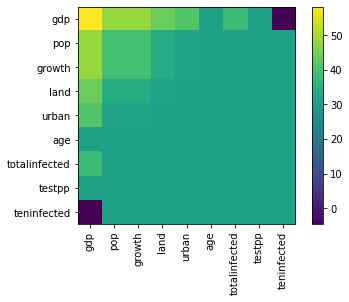

In [0]:
covMatrix = np.cov(X.T)
pl.imshow(np.log(covMatrix - covMatrix.min() + 0.01))
pl.colorbar()
pl.xticks(range(len(features)), features, rotation=90)
pl.yticks(range(len(features)), features);

In [0]:
importances = regr.feature_importances_
importances


std = np.std([tree.feature_importances_ for tree in regr.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]
importances[indices]

array([0.58079145, 0.16497833, 0.08920198, 0.07058925, 0.02456615,
       0.02255992, 0.01884475, 0.01636786, 0.01210031])

Feature ranking:
1. feature totalinfected (0.580791)
2. feature gdp (0.164978)
3. feature teninfected (0.089202)
4. feature urban (0.070589)
5. feature age (0.024566)
6. feature testpp (0.022560)
7. feature growth (0.018845)
8. feature pop (0.016368)
9. feature land (0.012100)


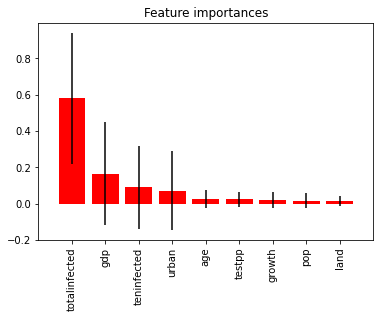

In [0]:

# Print the feature ranking
print("Feature ranking:")

for f in range(X.shape[1]):
    print("%d. feature %s (%f)" % (f + 1, np.array(features)[indices][f], importances[indices[f]]))

# Plot the feature importances of the forest
plt.figure()
plt.title("Feature importances")
plt.bar(range(X.shape[1]), importances[indices],
       color="r", yerr=std[indices], align="center")
plt.xticks(range(X.shape[1]), np.array(features)[indices], rotation=90)
plt.xlim([-1, X.shape[1]])
plt.show()

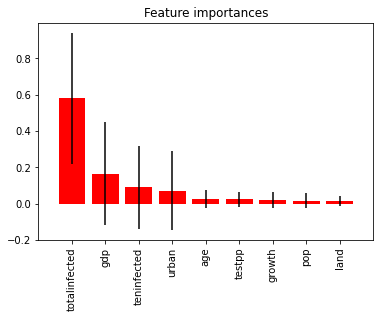

Feature ranking:
1. feature totalinfected (0.000002)
2. feature land (0.000015)
3. feature urban (0.024860)
4. feature gdp (0.088005)
5. feature age (0.231092)
6. feature pop (0.318776)
7. feature testpp (0.340498)
8. feature Intercept (0.341511)
9. feature growth (0.365511)


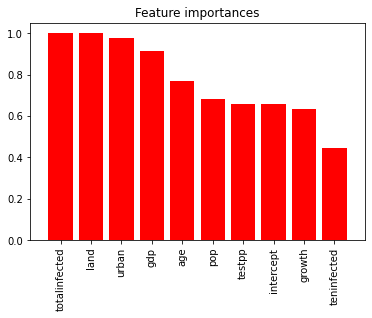

In [0]:
plt.figure()
plt.title("Feature importances")
plt.bar(range(X.shape[1]), importances[indices],
       color="r", yerr=std[indices], align="center")
plt.xticks(range(X.shape[1]),  np.array(features)[indices], rotation=90)
plt.xlim([-1, X.shape[1]])
plt.show()

importances = logtotaldeaths2.pvalues.values

indices = np.argsort(importances)

# Print the feature ranking
print("Feature ranking:")

for f in range(X.shape[1]):
    print("%d. feature %s (%f)" % (f + 1, 
        logtotaldeaths2.pvalues.index[indices[f]], importances[indices[f]]))

# Plot the feature importances of the forest
plt.figure()
plt.title("Feature importances")
plt.bar(range(X.shape[1] + 1), 1 - importances[indices],
       color="r",  align="center")
plt.xticks(range(X.shape[1] + 1), 
           list(np.array(["intercept"] + features)[indices]), 
rotation=90)
plt.xlim([-1, X.shape[1] + 1])
plt.show()



In [0]:
totaldeaths = smf.ols(formula="np.log10(totaldeaths +1)~ gdp + " + 
                      "pop	+ growth	+ land	+ urban + age + totalinfected + teninfected", 
                      data=formodeling).fit()
totaldeaths.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                OLS Regression Results                               
=====================================================================================
Dep. Variable:     np.log10(totaldeaths + 1)   R-squared:                       0.890
Model:                                   OLS   Adj. R-squared:                  0.854
Method:                        Least Squares   F-statistic:                     24.33
Date:                       Tue, 17 Mar 2020   Prob (F-statistic):           1.03e-07
Time:                               14:56:27   Log-Likelihood:                -7.5799
No. Observations:                         25   AIC:                             29.16
Df Residuals:                             18   BIC:                             37.69
Df Model:                                  6                                         
Covariance Type:                   nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept         0.0001    4.7e-05      2.566      0.019    2.18e-05       0.000
gdp            2.157e-13   1.27e-13      1.696      0.107   -5.15e-14    4.83e-13
pop            2.908e-10   1.99e-10      1.458      0.162   -1.28e-10     7.1e-10
growth         2.593e-10   1.98e-10      1.307      0.208   -1.58e-10    6.76e-10
land          -1.134e-06   1.91e-07     -5.930      0.000   -1.54e-06   -7.32e-07
urban          8.918e-06   3.54e-06      2.519      0.021    1.48e-06    1.64e-05
age              -0.0177      0.017     -1.068      0.300      -0.053       0.017
totalinfected  8.532e-05   1.22e-05      6.974      0.000    5.96e-05       0.000
teninfected       0.0090      0.004      2.566      0.019       0.002       0.016
==============================================================================
Omnibus:                        1.191   Durbin-Watson:                   1.456
Prob(Omnibus):                  0.551   Jarque-Bera (JB):                1.127
Skew:                           0.416   Prob(JB):                        0.569
Kurtosis:                       2.375   Cond. No.                     1.33e+29
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 3.25e-32. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [0]:
dead2test = smf.ols(formula="dead2test ~ " + 
                    "totalinfected + gdp +	pop	+growth	+ land + " + 
                    "urban +  age + tests", data=formodeling).fit()
dead2test.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              dead2test   R-squared:                       0.799
Model:                            OLS   Adj. R-squared:                  0.721
Method:                 Least Squares   F-statistic:                     10.22
Date:                Tue, 17 Mar 2020   Prob (F-statistic):           3.71e-05
Time:                        14:45:22   Log-Likelihood:                 113.43
No. Observations:                  26   AIC:                            -210.9
Df Residuals:                      18   BIC:                            -200.8
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept         0.0093      0.003      3.542      0.002       0.004       0.015
totalinfected  2.429e-06   4.52e-07      5.375      0.000    1.48e-06    3.38e-06
gdp            2.983e-15   1.64e-15      1.821      0.085   -4.59e-16    6.42e-15
pop            -2.13e-10   6.09e-11     -3.498      0.003   -3.41e-10   -8.51e-11
growth         2.192e-10   6.13e-11      3.574      0.002    9.03e-11    3.48e-10
land          -7.163e-09   2.01e-09     -3.563      0.002   -1.14e-08   -2.94e-09
urban          6.725e-09   5.07e-08      0.133      0.896   -9.97e-08    1.13e-07
age              -0.0004      0.000     -2.699      0.015      -0.001   -9.71e-05
tests         -5.352e-07   1.43e-07     -3.742      0.001   -8.36e-07   -2.35e-07
==============================================================================
Omnibus:                       14.453   Durbin-Watson:                   1.928
Prob(Omnibus):                  0.001   Jarque-Bera (JB):               15.980
Skew:                           1.306   Prob(JB):                     0.000339
Kurtosis:                       5.815   Cond. No.                     1.06e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 5.14e-14. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

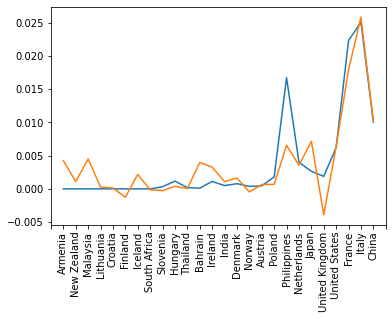

In [0]:
ax = formodeling["dead2test"].plot()
pl.plot(dead2test.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);


In [0]:
infected2test = smf.ols(formula="infected2test ~ " + 
                        "totalinfected + gdp +	pop	+ growth + " + 
                        "land	+ urban + age + tests", data=formodeling).fit()
infected2test.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          infected2test   R-squared:                       0.593
Model:                            OLS   Adj. R-squared:                  0.435
Method:                 Least Squares   F-statistic:                     3.746
Date:                Tue, 17 Mar 2020   Prob (F-statistic):             0.0112
Time:                        14:45:24   Log-Likelihood:                 17.784
No. Observations:                  26   AIC:                            -19.57
Df Residuals:                      18   BIC:                            -9.503
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept         0.2262      0.104      2.172      0.043       0.007       0.445
totalinfected  8.002e-05   1.79e-05      4.472      0.000    4.24e-05       0.000
gdp            1.404e-13   6.49e-14      2.164      0.044    4.12e-15    2.77e-13
pop           -5.134e-09   2.41e-09     -2.129      0.047   -1.02e-08   -6.86e-11
growth         5.331e-09   2.43e-09      2.196      0.041     2.3e-10    1.04e-08
land             3.4e-08   7.96e-08      0.427      0.674   -1.33e-07    2.01e-07
urban         -3.728e-06   2.01e-06     -1.857      0.080   -7.94e-06    4.89e-07
age              -0.0028      0.006     -0.437      0.668      -0.016       0.011
tests         -2.287e-05   5.66e-06     -4.037      0.001   -3.48e-05    -1.1e-05
==============================================================================
Omnibus:                       11.879   Durbin-Watson:                   2.546
Prob(Omnibus):                  0.003   Jarque-Bera (JB):               11.147
Skew:                           1.190   Prob(JB):                      0.00380
Kurtosis:                       5.152   Cond. No.                     1.06e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 5.14e-14. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

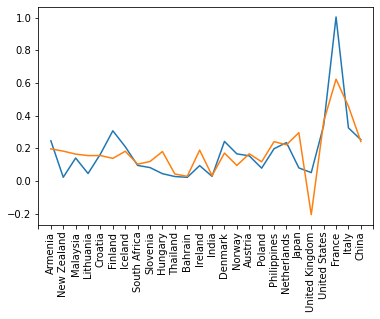

In [0]:
ax = formodeling["infected2test"].plot()
pl.plot(infected2test.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);


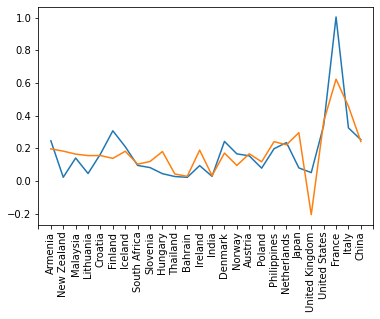

In [0]:
ax = formodeling["infected2test"].plot()
pl.plot(infected2test.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);


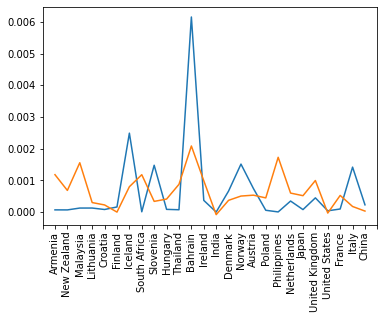

In [0]:
ax = formodeling["testpp"].plot()
pl.plot(testpp.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);


In [0]:
infected

,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,...,2020-02-07,2020-02-08,2020-02-09,2020-02-10,2020-02-11,2020-02-12,2020-02-13,2020-02-14,2020-02-15,2020-02-16,2020-02-17,2020-02-18,2020-02-19,2020-02-20,2020-02-21,2020-02-22,2020-02-23,2020-02-24,2020-02-25,2020-02-26,2020-02-27,2020-02-28,2020-02-29,2020-03-01,2020-03-02,2020-03-03,2020-03-04,2020-03-05,2020-03-06,2020-03-07,2020-03-08,2020-03-09,2020-03-10,2020-03-11,2020-03-12,2020-03-13,2020-03-14,2020-03-15,2020-03-16,teninfected
0,Afghanistan,33.0000,65.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.698970,0.698970,0.778151,0.903090,0.903090,0.903090,1.079181,1.230449,1.342423,73.0
1,Albania,41.1533,20.1683,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.477121,1.041393,1.113943,1.380211,1.531479,1.591065,1.633468,1.716003,70.0
2,Algeria,28.0339,1.6596,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.602060,0.778151,1.113943,1.113943,1.255273,1.255273,1.301030,1.322219,1.322219,1.322219,1.397940,1.431364,1.579784,1.690196,1.740363,63.0
3,Andorra,42.5063,1.5218,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.301030,0.477121,NaN
4,Antigua and Barbuda,17.0608,-61.7964,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.301030,0.301030,0.301030,0.301030,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151,Uruguay,-32.5228,-55.7658,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.698970,0.698970,0.954243,NaN
152,Uzbekistan,41.3775,64.5853,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0.000000,0.000000,0.000000,0.000000,0.0000

# Greg Dobler's analysis of the rate of infection

this par tof the analysis was performed by Greg Dobler (my husband and a colleague) on the evidence of a rutn over in the infection rate in various countries: China as a benchmark, Italy and the US, the countries we have a connection to


In [0]:

datag = infected.set_index("Country/Region").iloc[:, 2:N+2].T

In [0]:
datag.index = pd.to_datetime(datag.index)


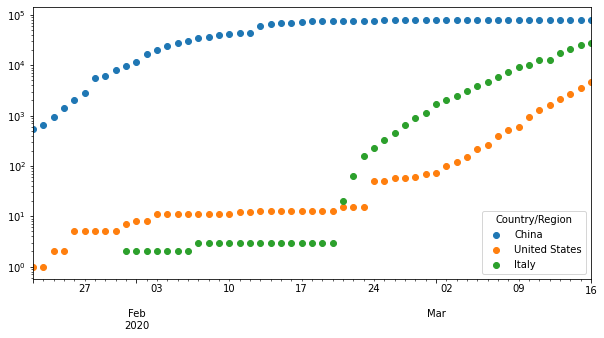

In [0]:
datag.plot(y=["China", "United States", "Italy"], use_index=True, 
           figsize=[10, 5], logy=True, style="o")

 ---

### **China: the infection rate turned around**

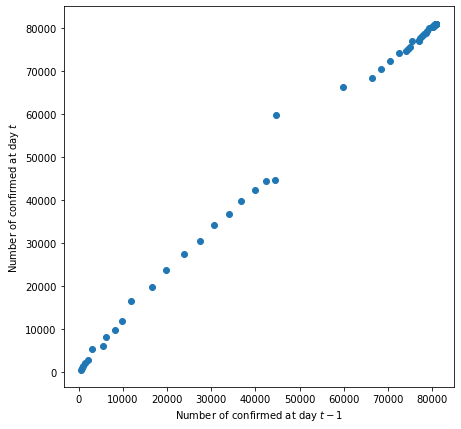

In [0]:
# -- plot day vs day-1
fig, ax = plt.subplots(figsize=[7, 7])
ax.scatter(datag[:]["China"].values[:-1], datag[:]["China"].values[1:])
ax.set_xlabel("Number of confirmed at day $t - 1$")
ax.set_ylabel("Number of confirmed at day $t$")
fig.show()

In [0]:
# -- fit two models

china_sub = datag[:]["China"].reset_index()
china_sub.columns = ["date", "counts"]
china_sub["day"] = np.arange(len(china_sub))
china_sub["lcounts"] = np.log10(china_sub["counts"])

lm0 = smf.ols("lcounts ~ day", data=china_sub)
lm1 = smf.ols("lcounts ~ day + np.power(day, 2)", data=china_sub)

res0 = lm0.fit()
res1 = lm1.fit()

pred0 = res0.predict(china_sub)
pred1 = res1.predict(china_sub)

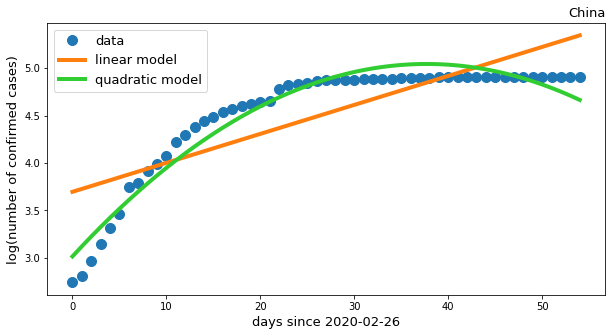

In [0]:
# -- plot results
fig, ax = plt.subplots(figsize=[10, 5])
ax.plot(china_sub["day"], china_sub["lcounts"], "o", ms=10, label="data")
ax.plot(china_sub["day"], pred0, lw=4, label="linear model")
ax.plot(china_sub["day"], pred1, lw=4, c="limegreen", label="quadratic model")
ax.set_xlabel("days since 2020-02-26", fontsize=13)
ax.set_ylabel("log(number of confirmed cases)", fontsize=13)
ax.set_title("China", loc="right", fontsize=13)
ax.legend(fontsize=13)
fig.show()

In [0]:
# -- likelihood ratio test
lr, pval, ddf = res1.compare_lr_test(res0)

print("the integrated probability that the observed likelihood ratio \n" + 
      "occurred by random chance is {0:.2g}".format(pval))

the integrated probability that the observed likelihood ratio 
occurred by random chance is 1.9e-24


---

### **US: no evidence or turnover yet**

In [0]:
# -- subset US
us_sub = datag[datag.index > "2020-02-29"]["United States"].reset_index()
us_sub.columns = ["date", "counts"]
us_sub["day"] = np.arange(len(us_sub))
us_sub["lcounts"] = np.log10(us_sub["counts"])

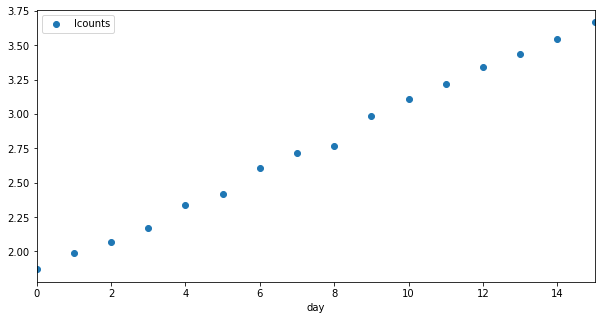

In [0]:
# -- plot it
us_sub.plot("day", "lcounts", style="o", figsize=[10, 5]);

In [0]:
# -- fit two models
lm0 = smf.ols("lcounts ~ day", data=us_sub)
lm1 = smf.ols("lcounts ~ day + np.power(day, 2)", data=us_sub)

res0 = lm0.fit()
res1 = lm1.fit()

pred0 = res0.predict(us_sub)
pred1 = res1.predict(us_sub)

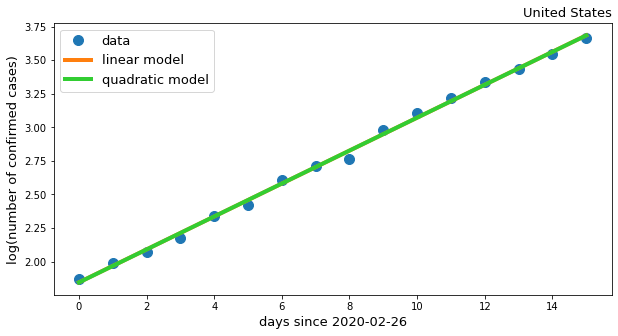

In [0]:
# -- plot results
fig, ax = plt.subplots(figsize=[10, 5])
ax.plot(us_sub["day"], us_sub["lcounts"], "o", ms=10, label="data")
ax.plot(us_sub["day"], pred0, lw=4, label="linear model")
ax.plot(us_sub["day"], pred1, lw=4, c="limegreen", label="quadratic model")
ax.set_xlabel("days since 2020-02-26", fontsize=13)
ax.set_ylabel("log(number of confirmed cases)", fontsize=13)
ax.set_title("United States", loc="right", fontsize=13)
ax.legend(fontsize=13)
fig.show()

In [0]:
# -- likelihood ratio test
lr, pval, ddf = res1.compare_lr_test(res0)

print("the integrated probability that the observed likelihood ratio \n" + 
      "occurred by random chance is {0:.2g}".format(pval))

the integrated probability that the observed likelihood ratio 
occurred by random chance is 0.96


---

### **Italy: just turned around!**

In [0]:
# -- subset Italy
it_sub = datag[datag.index > "2020-02-29"]["Italy"].reset_index()
it_sub.columns = ["date", "counts"]
it_sub["day"] = np.arange(len(it_sub))
it_sub["lcounts"] = np.log10(it_sub["counts"])

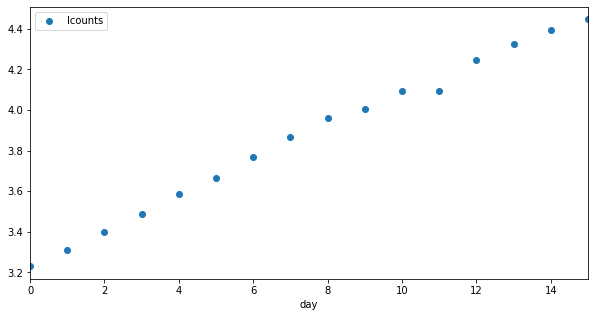

In [0]:
# -- plot it
it_sub.plot("day", "lcounts", style="o", figsize=[10, 5]);

In [0]:
# -- fit two models
lm0 = smf.ols("lcounts ~ day", data=it_sub)
lm1 = smf.ols("lcounts ~ day + np.power(day, 2)", data=it_sub)

res0 = lm0.fit()
res1 = lm1.fit()

pred0 = res0.predict(it_sub)
pred1 = res1.predict(it_sub)

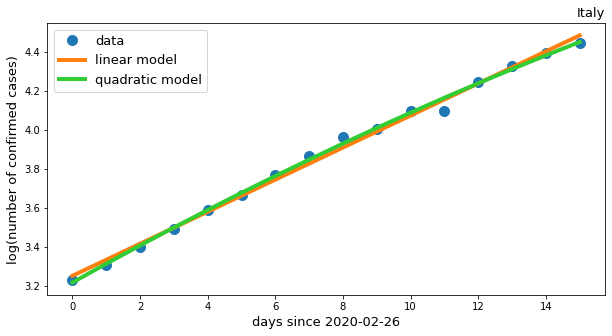

In [0]:
# -- plot results
fig, ax = plt.subplots(figsize=[10, 5])
ax.plot(it_sub["day"], it_sub["lcounts"], "o", ms=10, label="data")
ax.plot(it_sub["day"], pred0, lw=4, label="linear model")
ax.plot(it_sub["day"], pred1, lw=4, c="limegreen", label="quadratic model")
ax.set_xlabel("days since 2020-02-26", fontsize=13)
ax.set_ylabel("log(number of confirmed cases)", fontsize=13)
ax.set_title("Italy", loc="right", fontsize=13)
ax.legend(fontsize=13)
fig.show()

In [0]:
# -- likelihood ratio test
lr, pval, ddf = res1.compare_lr_test(res0)

print("the integrated probability that the observed likelihood ratio \n" + 
      "occurred by random chance is {0:.2g}".format(pval))

the integrated probability that the observed likelihood ratio 
occurred by random chance is 0.0027
